<a href="https://colab.research.google.com/github/adrak-sleeps/Crop-Disease-Detection-using-Drone/blob/main/Crop_Disease_Detection_using_ResNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Crop disease detection using ResNet**

## **Downloading the PlantVillage Dataset**

In [ ]:
!pip install -q kaggle
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"ansitabehera","key":"eb8e57d47a18c3801e5d07dcb050c9c4"}\r\n\r\n'}

In [ ]:
# Downloading the PlantVillage dataset from Kaggle and unzipping it.
%%capture
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d vipoooool/new-plant-diseases-dataset
!unzip /content/new-plant-diseases-dataset.zip

## **Importing necessary libraries**

In [ ]:
!pip install torchsummary

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os                       # for working with files
import numpy as np              # for numerical computationss
import pandas as pd             # for working with dataframes
import torch                    # Pytorch module 
import matplotlib.pyplot as plt # for plotting informations on graph and images using tensors
import torch.nn as nn           # for creating  neural networks
from torch.utils.data import DataLoader # for dataloaders 
from PIL import Image           # for checking images
import torch.nn.functional as F # for functions for calculating loss
import torchvision.transforms as transforms   # for transforming images into tensors 
from torchvision.utils import make_grid       # for data checking
from torchvision.datasets import ImageFolder  # for working with classes and images
from torchsummary import summary              # for getting the summary of our model

%matplotlib inline

# **Exploratory Data Analysis**

In [ ]:
data_dir = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)"
train_dir = data_dir + "/train"
valid_dir = data_dir + "/valid"
diseases = os.listdir(train_dir)

In [ ]:
# printing the disease names
print(diseases)

['Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Tomato___Bacterial_spot', 'Grape___Black_rot', 'Apple___Apple_scab', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Apple___healthy', 'Strawberry___Leaf_scorch', 'Cherry_(including_sour)___Powdery_mildew', 'Corn_(maize)___Common_rust_', 'Potato___Late_blight', 'Apple___Cedar_apple_rust', 'Pepper,_bell___Bacterial_spot', 'Tomato___Early_blight', 'Potato___Early_blight', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Peach___Bacterial_spot', 'Corn_(maize)___Northern_Leaf_Blight', 'Potato___healthy', 'Raspberry___healthy', 'Tomato___Target_Spot', 'Tomato___Leaf_Mold', 'Grape___healthy', 'Corn_(maize)___healthy', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy', 'Pepper,_bell___healthy', 'Squash___Powdery_mildew', 'Orange___Haunglongbing_(Citrus_greening)', 'Blueberry___healthy', 'Strawberry___healthy', 'Soybean___healthy', 'Grape___Esca_(Black_Measles)', 'Peach___healthy', 'Apple___Black

In [ ]:
print("Total disease and healthy classes are: {}".format(len(diseases)))

Total disease and healthy classes are: 38


In [ ]:
plants = []
disease = []
NumberOfDiseases = 0
for plant in diseases:
    if plant.split('___')[0] not in plants:
        plants.append(plant.split('___')[0])
    if plant.split('___')[1] != 'healthy':
        NumberOfDiseases += 1
        disease.append(plant.split('___')[1])

In [ ]:
print(f"Unique Diseases are: \n {disease}")

Unique Diseases are: 
 ['Leaf_blight_(Isariopsis_Leaf_Spot)', 'Bacterial_spot', 'Black_rot', 'Apple_scab', 'Tomato_Yellow_Leaf_Curl_Virus', 'Leaf_scorch', 'Powdery_mildew', 'Common_rust_', 'Late_blight', 'Cedar_apple_rust', 'Bacterial_spot', 'Early_blight', 'Early_blight', 'Cercospora_leaf_spot Gray_leaf_spot', 'Spider_mites Two-spotted_spider_mite', 'Bacterial_spot', 'Northern_Leaf_Blight', 'Target_Spot', 'Leaf_Mold', 'Tomato_mosaic_virus', 'Powdery_mildew', 'Haunglongbing_(Citrus_greening)', 'Esca_(Black_Measles)', 'Black_rot', 'Septoria_leaf_spot', 'Late_blight']


In [ ]:
print("Number of diseases (excluding healthy): {}".format(len(disease)))

Number of diseases (excluding healthy): 26


In [ ]:
# unique plants in the dataset
print(f"Unique Plants are: \n{plants}")

Unique Plants are: 
['Grape', 'Tomato', 'Apple', 'Strawberry', 'Cherry_(including_sour)', 'Corn_(maize)', 'Potato', 'Pepper,_bell', 'Peach', 'Raspberry', 'Squash', 'Orange', 'Blueberry', 'Soybean']


In [ ]:
# number of unique plants
print("Number of plants: {}".format(len(plants)))

Number of plants: 14


In [ ]:
# Number of images for each disease
nums = {}
for disease in diseases:
    nums[disease] = q + '/' + disease))
    
# converting the nums dictionary to pandas dataframe passing index as plant name and number of images as column

img_per_class = pd.DataFrame(nums.values(), index=nums.keys(), columns=["no. of images"])
img_per_class

,no. of images
Grape___Leaf_blight_(Isariopsis_Leaf_Spot),1722
Tomato___Bacterial_spot,1702
Grape___Black_rot,1888
Apple___Apple_scab,2016
Tomato___Tomato_Yellow_Leaf_Curl_Virus,1961
Apple___healthy,2008
Strawberry___Leaf_scorch,1774
Cherry_(including_sour)___Powdery_mildew,1683
Corn_(maize)___Common_rust_,1907
Potato___Late_blight,1939


Text(0.5, 1.0, 'Images per each class of plant disease')

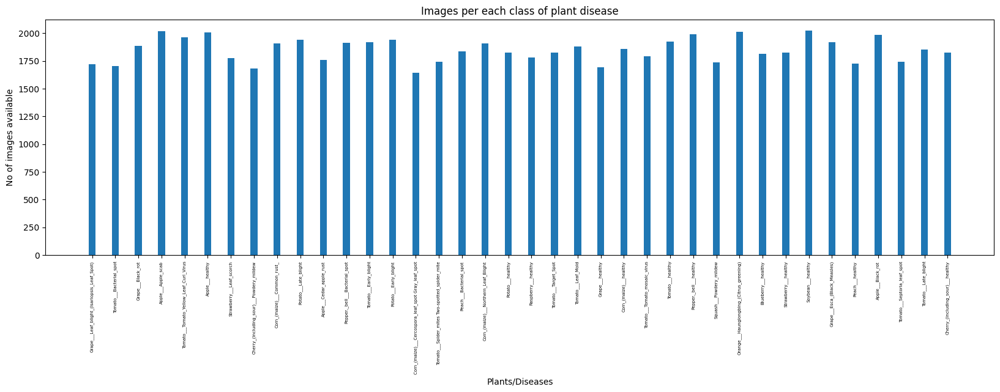

In [ ]:
# plotting number of images available for each disease

index = [n for n in range(38)]
plt.figure(figsize=(20, 5))
plt.bar(index, [n for n in nums.values()], width=0.3)
plt.xlabel('Plants/Diseases', fontsize=10)
plt.ylabel('No of images available', fontsize=10)
plt.xticks(index, diseases, fontsize=5, rotation=90)
plt.title('Images per each class of plant disease')

In [ ]:
n_train = 0
for value in nums.values():
    n_train += value
print(f"There are {n_train} images for training")

There are 70295 images for training


# **Preparing the data for training**

In [ ]:
# datasets for validation and training
train = ImageFolder(train_dir, transform=transforms.ToTensor())
valid = ImageFolder(valid_dir, transform=transforms.ToTensor()) 

In [ ]:
# for checking some images from training dataset
def show_image(image, label):
    print("Label :" + train.classes[label] + "(" + str(label) + ")")
    plt.imshow(image.permute(1, 2, 0))

In [ ]:
# Setting the seed value
random_seed = 7
torch.manual_seed(random_seed)

In [ ]:
# setting the batch size
batch_size = 32

In [ ]:
# DataLoaders for training and validation
train_dl = DataLoader(train, batch_size, shuffle=True, num_workers=2, pin_memory=True)
valid_dl = DataLoader(valid, batch_size, num_workers=2, pin_memory=True)

In [ ]:
# helper function to show a batch of training instances
def show_batch(data):
    for images, labels in data:
        fig, ax = plt.subplots(figsize=(30, 30))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(images, nrow=8).permute(1, 2, 0))
        break

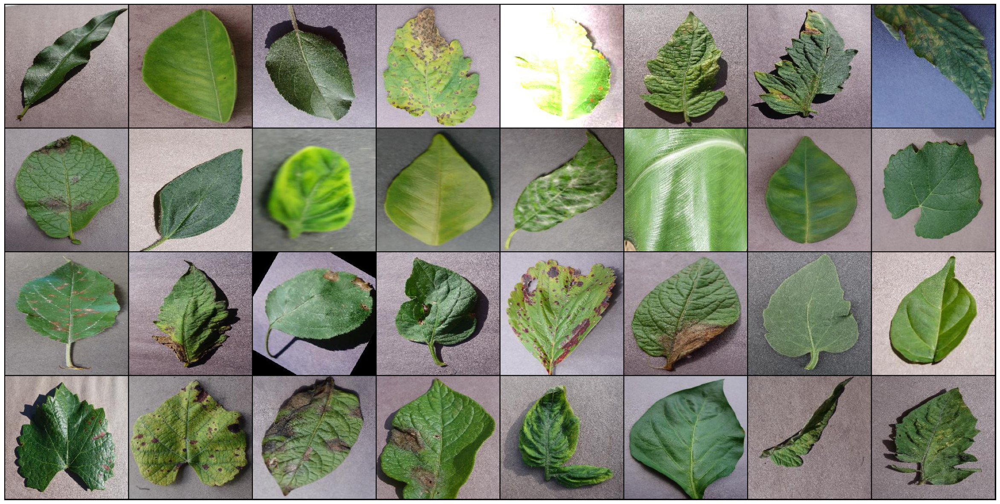

In [ ]:
# Images for first batch of training
show_batch(train_dl) 

# **Some helper functions**

In [ ]:
# for moving data into GPU (if available)
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available:
        return torch.device("cuda")
    else:
        return torch.device("cpu")

# for moving data to device (CPU or GPU)
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

# for loading in the device (GPU if available else CPU)
class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl:
            yield to_device(b, self.device)
        
    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [ ]:
device = get_default_device()
device

device(type='cuda')

In [ ]:
# Moving data into GPU
train_dl = DeviceDataLoader(train_dl, device)
valid_dl = DeviceDataLoader(valid_dl, device)

# **Building the Model**

In [ ]:
class SimpleResidualBlock(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=3, kernel_size=3, stride=1, padding=1)
        self.relu1 = nn.ReLU()
        self.conv2 = nn.Conv2d(in_channels=3, out_channels=3, kernel_size=3, stride=1, padding=1)
        self.relu2 = nn.ReLU()
        
    def forward(self, x):
        out = self.conv1(x)
        out = self.relu1(out)
        out = self.conv2(out)
        return self.relu2(out) + x # ReLU can be applied before or after adding the input

In [ ]:
# for calculating the accuracy
def accuracy(outputs, labels):
    _, preds = torch.max(outputs, dim=1)
    return torch.tensor(torch.sum(preds == labels).item() / len(preds))


# base class for the model
class ImageClassificationBase(nn.Module):
    
    def training_step(self, batch):
        images, labels = batch
        out = self(images)                  # Generate predictions
        loss = F.cross_entropy(out, labels) # Calculate loss
        return loss
    
    def validation_step(self, batch):
        images, labels = batch
        out = self(images)                   # Generate prediction
        loss = F.cross_entropy(out, labels)  # Calculate loss
        acc = accuracy(out, labels)          # Calculate accuracy
        return {"val_loss": loss.detach(), "val_accuracy": acc}
    
    def validation_epoch_end(self, outputs):
        batch_losses = [x["val_loss"] for x in outputs]
        batch_accuracy = [x["val_accuracy"] for x in outputs]
        epoch_loss = torch.stack(batch_losses).mean()       # Combine loss  
        epoch_accuracy = torch.stack(batch_accuracy).mean()
        return {"val_loss": epoch_loss, "val_accuracy": epoch_accuracy} # Combine accuracies
    
    def epoch_end(self, epoch, result):
        print("Epoch [{}], last_lr: {:.5f}, train_loss: {:.4f}, val_loss: {:.4f}, val_acc: {:.4f}".format(
            epoch, result['lrs'][-1], result['train_loss'], result['val_loss'], result['val_accuracy']))
        

In [ ]:
# Architecture for training

# convolution block with BatchNormalization
def ConvBlock(in_channels, out_channels, pool=False):
    layers = [nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
             nn.BatchNorm2d(out_channels),
             nn.ReLU(inplace=True)]
    if pool:
        layers.append(nn.MaxPool2d(4))
    return nn.Sequential(*layers)


# resnet architecture 
class ResNet9(ImageClassificationBase):
    def __init__(self, in_channels, num_diseases):
        super().__init__()
        
        self.conv1 = ConvBlock(in_channels, 64)
        self.conv2 = ConvBlock(64, 128, pool=True) # out_dim : 128 x 64 x 64 
        self.res1 = nn.Sequential(ConvBlock(128, 128), ConvBlock(128, 128))
        
        self.conv3 = ConvBlock(128, 256, pool=True) # out_dim : 256 x 16 x 16
        self.conv4 = ConvBlock(256, 512, pool=True) # out_dim : 512 x 4 x 44
        self.res2 = nn.Sequential(ConvBlock(512, 512), ConvBlock(512, 512))
        
        self.classifier = nn.Sequential(nn.MaxPool2d(4),
                                       nn.Flatten(),
                                       nn.Linear(512, num_diseases))
        
    def forward(self, xb): # xb is the loaded batch
        out = self.conv1(xb)
        out = self.conv2(out)
        out = self.res1(out) + out
        out = self.conv3(out)
        out = self.conv4(out)
        out = self.res2(out) + out
        out = self.classifier(out)
        return out        

In [ ]:
# defining the model and moving it to the GPU
model = to_device(ResNet9(3, len(train.classes)), device) 
model
# model = ResNet9(3, len(train.classes))

ResNet9(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (res1): Sequential(
    (0): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=Tr

In [ ]:
# getting summary of the model
INPUT_SHAPE = (3, 256, 256)
print(summary(model.cuda(), (INPUT_SHAPE)))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4        [-1, 128, 256, 256]          73,856
       BatchNorm2d-5        [-1, 128, 256, 256]             256
              ReLU-6        [-1, 128, 256, 256]               0
         MaxPool2d-7          [-1, 128, 64, 64]               0
            Conv2d-8          [-1, 128, 64, 64]         147,584
       BatchNorm2d-9          [-1, 128, 64, 64]             256
             ReLU-10          [-1, 128, 64, 64]               0
           Conv2d-11          [-1, 128, 64, 64]         147,584
      BatchNorm2d-12          [-1, 128, 64, 64]             256
             ReLU-13          [-1, 128, 64, 64]               0
           Conv2d-14          [-1, 256,

In [ ]:
# for training
@torch.no_grad()
def evaluate(model, val_loader):
    model.eval()
    outputs = [model.validation_step(batch) for batch in val_loader]
    return model.validation_epoch_end(outputs)


def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        # return 0.005
        return param_group['lr']
    

def fit_OneCycle(epochs, max_lr, model, train_loader, val_loader, weight_decay=0,
                grad_clip=None, opt_func=torch.optim.SGD):
    torch.cuda.empty_cache()
    history = []
    
    optimizer = opt_func(model.parameters(), max_lr, weight_decay=weight_decay)
    # scheduler for one cycle learniing rate
    sched = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr, epochs=epochs, steps_per_epoch=len(train_loader))
    
    
    for epoch in range(epochs):
        # Training
        model.train()
        train_losses = []
        lrs = []
        for batch in train_loader:
            # loss = model.training_step(batch)
            loss = model.training_step(batch)
            train_losses.append(loss)
            loss.backward()
            
            # gradient clipping
            if grad_clip: 
                nn.utils.clip_grad_value_(model.parameters(), grad_clip)
                
            optimizer.step()
            optimizer.zero_grad()
            
            # recording and updating learning rates
            lrs.append(get_lr(optimizer))
            sched.step()
            
    
        # validation
        result = evaluate(model, val_loader)
        result['train_loss'] = torch.stack(train_losses).mean().item()
        result['lrs'] = lrs
        model.epoch_end(epoch, result)
        history.append(result)
        
    return history
    

# **Training the Model**

In [ ]:
%%time
history = [evaluate(model, valid_dl)]
history

CPU times: user 1min 1s, sys: 3.92 s, total: 1min 5s
Wall time: 1min 15s


[{'val_loss': tensor(3.6378, device='cuda:0'), 'val_accuracy': tensor(0.0282)}]

In [ ]:
epochs = 2
max_lr = 0.01
grad_clip = 0.1
weight_decay = 1e-4
opt_func = torch.optim.Adam

In [ ]:
%%time
history += fit_OneCycle(epochs, max_lr, model, train_dl, valid_dl, 
                             grad_clip=grad_clip, 
                             weight_decay=1e-4, 
                             opt_func=opt_func)

Epoch [0], last_lr: 0.00812, train_loss: 0.7573, val_loss: 0.6355, val_acc: 0.8114
Epoch [1], last_lr: 0.00000, train_loss: 0.1273, val_loss: 0.0287, val_acc: 0.9916
CPU times: user 15min 34s, sys: 16min 51s, total: 32min 26s
Wall time: 33min 33s


In [ ]:
import torch
torch.save(model, "/content/Model.pth")


# # to load model 
model = torch.load("/content/Model.pth")


## **Crop Disease Detection using the above ResNet model is giving 99.2% accuracy.**

# **Plotting the Results**




In [ ]:
def plot_accuracies(history):
    accuracies = [x['val_accuracy'] for x in history]
    plt.plot(accuracies, '-x')
    plt.xlabel('epoch')
    plt.ylabel('accuracy')
    plt.title('Accuracy vs. No. of epochs');


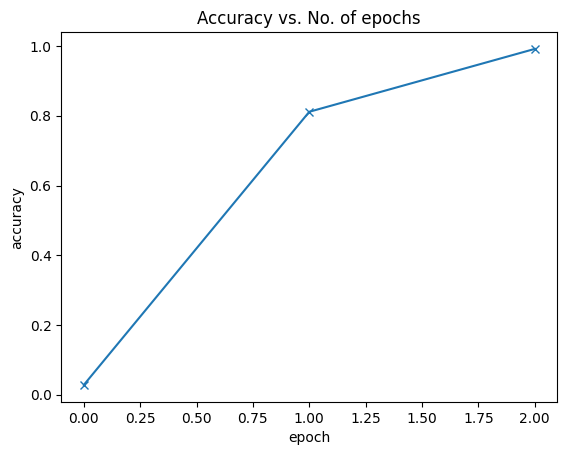

In [ ]:
plot_accuracies(history)

## **Testing**

In [ ]:
test_dir = "/content/test"
test = ImageFolder(test_dir, transform=transforms.ToTensor())


from PIL import Image
import os, sys
path = ('/content/test/test')

def resize():
    for item in os.listdir(path):
        if os.path.isfile(path+item):
            im = Image.open(path+item)
            f, e = os.path.splitext(path+item)
            imResize = im.resize((256,256), Image.ANTIALIAS)
            imResize.save(f + ' resized.jpg', 'JPG', quality=90)

resize()

In [ ]:
test_images = sorted(os.listdir(test_dir + '/test')) # since images in test folder are in alphabetical order
test_images

['AppleCedarRust1.JPG',
 'AppleCedarRust2.JPG',
 'AppleCedarRust3.JPG',
 'AppleCedarRust4.JPG',
 'AppleScab1.JPG',
 'AppleScab2.JPG',
 'AppleScab3.JPG',
 'CornCommonRust1.JPG',
 'CornCommonRust2.JPG',
 'CornCommonRust3.JPG',
 'PotatoEarlyBlight1.JPG',
 'PotatoEarlyBlight2.JPG',
 'PotatoEarlyBlight3.JPG',
 'PotatoEarlyBlight4.JPG',
 'PotatoEarlyBlight5.JPG',
 'PotatoHealthy1.JPG',
 'PotatoHealthy2.JPG',
 'TomatoEarlyBlight1.JPG',
 'TomatoEarlyBlight2.JPG',
 'TomatoEarlyBlight3.JPG',
 'TomatoEarlyBlight4.JPG',
 'TomatoEarlyBlight5.JPG',
 'TomatoEarlyBlight6.JPG',
 'TomatoHealthy1.JPG',
 'TomatoHealthy2.JPG',
 'TomatoHealthy3.JPG',
 'TomatoHealthy4.JPG',
 'TomatoYellowCurlVirus1.JPG',
 'TomatoYellowCurlVirus2.JPG',
 'TomatoYellowCurlVirus3.JPG',
 'TomatoYellowCurlVirus4.JPG',
 'TomatoYellowCurlVirus5.JPG',
 'TomatoYellowCurlVirus6.JPG']

In [ ]:
def predict_image(img, model):
    """Converts image to array and return the predicted class
        with highest probability"""
    # Convert to a batch of 1
    xb = to_device(img.unsqueeze(0), device)
    # Get predictions from model
    yb = model(xb)
    # Pick index with highest probability
    _, preds  = torch.max(yb, dim=1)
    # Retrieve the class label

    return train.classes[preds[0].item()]

Label: AppleCedarRust1.JPG , Predicted: Apple___Cedar_apple_rust


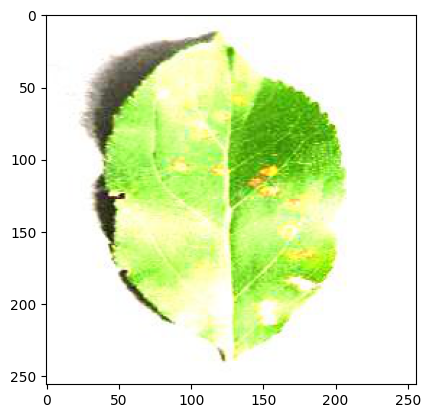

In [ ]:
# predicting first image
img, label = test[0]
plt.imshow(img.permute(1, 2, 0))
print('Label:', test_images[0], ', Predicted:', predict_image(img, model))

In [ ]:
# getting all predictions (actual label vs predicted)
for i, (img, label) in enumerate(test):
    print('Label:', test_images[i], ', Predicted:', predict_image(img, model))

Label: AppleCedarRust1.JPG , Predicted: Apple___Cedar_apple_rust
Label: AppleCedarRust2.JPG , Predicted: Apple___Cedar_apple_rust
Label: AppleCedarRust3.JPG , Predicted: Apple___Cedar_apple_rust
Label: AppleCedarRust4.JPG , Predicted: Apple___Cedar_apple_rust
Label: AppleScab1.JPG , Predicted: Apple___Apple_scab
Label: AppleScab2.JPG , Predicted: Apple___Apple_scab
Label: AppleScab3.JPG , Predicted: Apple___Apple_scab
Label: CornCommonRust1.JPG , Predicted: Corn_(maize)___Common_rust_
Label: CornCommonRust2.JPG , Predicted: Corn_(maize)___Common_rust_
Label: CornCommonRust3.JPG , Predicted: Corn_(maize)___Common_rust_
Label: PotatoEarlyBlight1.JPG , Predicted: Potato___Early_blight
Label: PotatoEarlyBlight2.JPG , Predicted: Potato___Early_blight
Label: PotatoEarlyBlight3.JPG , Predicted: Potato___Early_blight
Label: PotatoEarlyBlight4.JPG , Predicted: Potato___Early_blight
Label: PotatoEarlyBlight5.JPG , Predicted: Potato___Early_blight
Label: PotatoHealthy1.JPG , Predicted: Potato___h

# **Simulating a drone dataset**

# **Method 1: Modifying the Dataset**

In [ ]:
from PIL import Image, ImageFilter
import os, sys
import cv2
path = ("/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train")
new_path = ("/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir")

os.mkdir(new_path)

In [ ]:
os.mkdir(new_path + '/train')
os.mkdir(new_path + '/test')

In [ ]:
os.listdir(path)

['Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Tomato___Bacterial_spot',
 'Grape___Black_rot',
 'Apple___Apple_scab',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Apple___healthy',
 'Strawberry___Leaf_scorch',
 'Cherry_(including_sour)___Powdery_mildew',
 'Corn_(maize)___Common_rust_',
 'Potato___Late_blight',
 'Apple___Cedar_apple_rust',
 'Pepper,_bell___Bacterial_spot',
 'Tomato___Early_blight',
 'Potato___Early_blight',
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Peach___Bacterial_spot',
 'Corn_(maize)___Northern_Leaf_Blight',
 'Potato___healthy',
 'Raspberry___healthy',
 'Tomato___Target_Spot',
 'Tomato___Leaf_Mold',
 'Grape___healthy',
 'Corn_(maize)___healthy',
 'Tomato___Tomato_mosaic_virus',
 'Tomato___healthy',
 'Pepper,_bell___healthy',
 'Squash___Powdery_mildew',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Blueberry___healthy',
 'Strawberry___healthy',
 'Soybean___healthy',
 'Grape___Esca_(Black_Measles)',
 

In [ ]:
for (z1, z2, z3) in os.walk(path):
  print(z1)

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/Tomato___Bacterial_spot
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/Grape___Black_rot
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/Apple___Apple_scab
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/Tomato___Tomato_Yellow_Leaf_Curl_Virus
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/Apple___healthy
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/Strawberry___Leaf_scorch
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/tra

In [ ]:
import shutil

for(root, dirs, files) in os.walk(path):
  for item in dirs:
    x = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/" + item
    if os.path.exists(x):
      print(item)
    else:
      os.mkdir(x)

    # y = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir_sharp/train/" + item
    # if os.path.exists(y):
    #   print(item)
    # else:
    #   os.mkdir(y)

In [ ]:
import shutil

for(root, dirs, files) in os.walk(path):
  for item in dirs:
    x = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/" + item
    if os.path.exists(x):
      print(item)
    else:
      os.mkdir(x)

    # y = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir_sharp/test/" + item
    # if os.path.exists(y):
    #   print(item)
    # else:
    #   os.mkdir(y)

In [ ]:
import pathlib
import shutil
for(root, dirs, files) in os.walk(path):

  if root == "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train":
    continue
  src = root
  it = 0
  for item in os.listdir(src):
    x = pathlib.PurePath(src)
    y = x.name
    dest1 = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/" + y
    # dest2 = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir_sharp/train/" + y
    # print("To be copied from " + src + "to " + dir_name )

    a = src + '/' + item
    b = dest1 + '/' + item
    # c = dest2 + '/' + item
    shutil.copy( a , b)
    # shutil.copy( a, c)

    it += 1
    if it > 9:
      break

for(root, dirs, files) in os.walk('/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid'):

  if root == "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid":
    continue
  src = root
  it = 0
  for item in os.listdir(src):
    x = pathlib.PurePath(src)
    y = x.name
    dest1 = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/" + y
    # dest2 = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir_sharp/test/" + y
    # print("To be copied from " + src + "to " + dir_name )

    a = src + '/' + item
    b = dest1 + '/' + item
    # c = dest2 + '/' + item
    shutil.copy( a , b)
    # shutil.copy( a, c)

    it += 1
    if it > 4:
      break

In [ ]:
from skimage import filters
from PIL import Image
import cv2 as cv
from scipy.ndimage import zoom

def blur(img):
    # imMod = img.filter(ImageFilter.BLUR)
    # return imMod
    sigma = 3.0
    blurred = filters.gaussian(img, sigma=(sigma, sigma), truncate=3.5, channel_axis=2)
    return blurred

def motion_blur(img):

    import random
    # The greater the size, the more the motion.
    kernel_size = 10
    kernel_v = np.zeros((kernel_size, kernel_size))
    kernel_h = np.copy(kernel_v)

    kernel_v[:, int((kernel_size - 1)/2)] = np.ones(kernel_size)
    kernel_h[int((kernel_size - 1)/2), :] = np.ones(kernel_size)

    kernel_v /= kernel_size
    kernel_h /= kernel_size

    vertical_mb = cv2.filter2D(img, -1, kernel_v)
    horizontal_mb = cv2.filter2D(img, -1, kernel_h)

    return horizontal_mb


def clipped_zoom(img, zoom_factor, **kwargs):

    h, w = img.shape[:2]
    zoom_tuple = (zoom_factor,) * 2 + (1,) * (img.ndim - 2)

    # Zooming out
    if zoom_factor < 1:

        # Bounding box of the zoomed-out image within the output array
        zh = int(np.round(h * zoom_factor))
        zw = int(np.round(w * zoom_factor))
        top = (h - zh) // 2
        left = (w - zw) // 2

        # Zero-padding
        out = np.zeros_like(img)
        out[top:top+zh, left:left+zw] = zoom(img, zoom_tuple, **kwargs)

    # Zooming in
    elif zoom_factor > 1:

        # Bounding box of the zoomed-in region within the input array
        zh = int(np.round(h / zoom_factor))
        zw = int(np.round(w / zoom_factor))
        top = (h - zh) // 2
        left = (w - zw) // 2

        out = zoom(img[top:top+zh, left:left+zw], zoom_tuple, **kwargs)

        # `out` might still be slightly larger than `img` due to rounding, so
        # trim off any extra pixels at the edges
        trim_top = ((out.shape[0] - h) // 2)
        trim_left = ((out.shape[1] - w) // 2)
        out = out[trim_top:trim_top+h, trim_left:trim_left+w]

    # If zoom_factor == 1, just return the input array
    else:
        out = img
    return out


/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/Tomato___healthy/d2d4ff14-b875-4b6f-93d5-ef48ec437e86___RS_HL 0362.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/Tomato___healthy/2a7e1698-9747-40e6-994e-5d4dc1d2b239___RS_HL 0279_newPixel25.JPG
blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/Tomato___healthy/0cb10f98-491d-4e1f-b8ea-4fb0f1b3675f___GH_HL Leaf 333_new30degFlipLR.JPG
blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/Tomato___healthy/930689fd-9e44-497a-9724-7e7080de02fe___RS_HL 9754.JPG
blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/Tomato___healthy/d45c5eb7-c7b7-430b-9b2c-917a4a34315e___RS_HL 0151.JPG
Motion blur
(256, 256, 3)
/content/Ne

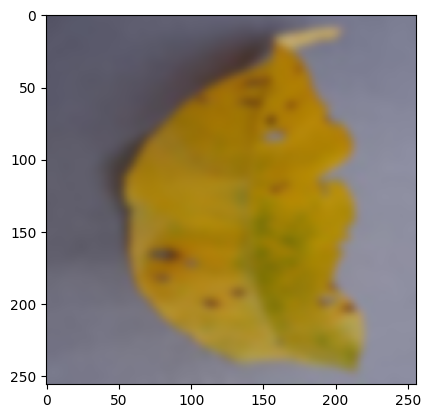

In [ ]:
import random
from google.colab.patches import cv2_imshow
import imageio.v3 as iio

for item in os.listdir(new_path + '/train'):
  x = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/" + item
  for item2 in os.listdir(x):
    rand = random.randint(0,5)
    img = Image.open(x+'/'+item2)

    addr = x+'/'+item2
    print(addr)
    # print(img)
    if rand == 0:
      img = iio.imread(addr)
      mod_img = blur(img)
      plt.imshow(mod_img)
      # cv2.imwrite(addr, mod_img)
      print("blur")
      # mod_img.show()
      print(mod_img.shape)

    elif rand == 1 or rand == 2 or rand == 3 or rand == 4:
      img = cv2.imread(addr)
      mod_img = motion_blur(img)
      cv2.imwrite(addr, mod_img)
      print("Motion blur")
      # cv2_imshow(mod_img)
      print(mod_img.shape)

    else:
      img = cv2.imread(addr)
      mod_img = clipped_zoom(img, 0.5)
      cv2.imwrite(addr, mod_img)
      print("Zoom")
      # cv2_imshow(mod_img)
      print(mod_img.shape)


/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___healthy/4bd918e2-ac0a-41b4-b1a0-f1bb799a309c___RS_HL 9846.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___healthy/45167988-3f78-4309-8ce2-633d7521847f___GH_HL Leaf 432.1.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___healthy/efe02473-2f94-4ff5-a478-cc9d8ebd79da___RS_HL 9671.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___healthy/6b53630d-c9df-4e67-a490-b1835772d9a0___GH_HL Leaf 450.2.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___healthy/3ea001ac-b49b-4382-a95d-a602fba00a5a___GH_HL Leaf 445.JPG
Motion blur
(256, 256, 3)
/content/

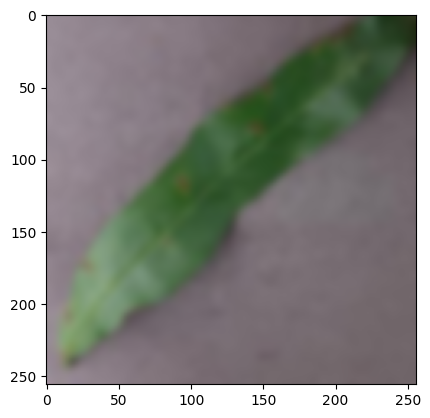

In [ ]:
for item in os.listdir(new_path + '/test'):
  x = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/" + item
  for item2 in os.listdir(x):
    rand = random.randint(0,5)
    img = Image.open(x+'/'+item2)

    addr = x+'/'+item2
    print(addr)
    # print(img)
    if rand == 0:
      img = iio.imread(addr)
      mod_img = blur(img)
      plt.imshow(mod_img)
      # cv2.imwrite(addr, mod_img)
      print("blur")
      # mod_img.show()
      print(mod_img.shape)

    elif rand == 1 or rand == 2 or rand == 3 or rand == 4:
      img = cv2.imread(addr)
      mod_img = motion_blur(img)
      cv2.imwrite(addr, mod_img)
      print("Motion blur")
      # cv2_imshow(mod_img)
      print(mod_img.shape)

    else:
      img = cv2.imread(addr)
      mod_img = clipped_zoom(img, 0.5)
      cv2.imwrite(addr, mod_img)
      print("Zoom")
      # cv2_imshow(mod_img)
      print(mod_img.shape)

In [ ]:
valid_mod_dir = '/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test'
valid_mod = ImageFolder(valid_mod_dir, transform=transforms.ToTensor()) 

In [ ]:
batch_size = 32
valid_mod_dl = DataLoader(valid_mod, batch_size, num_workers=2, pin_memory=True)

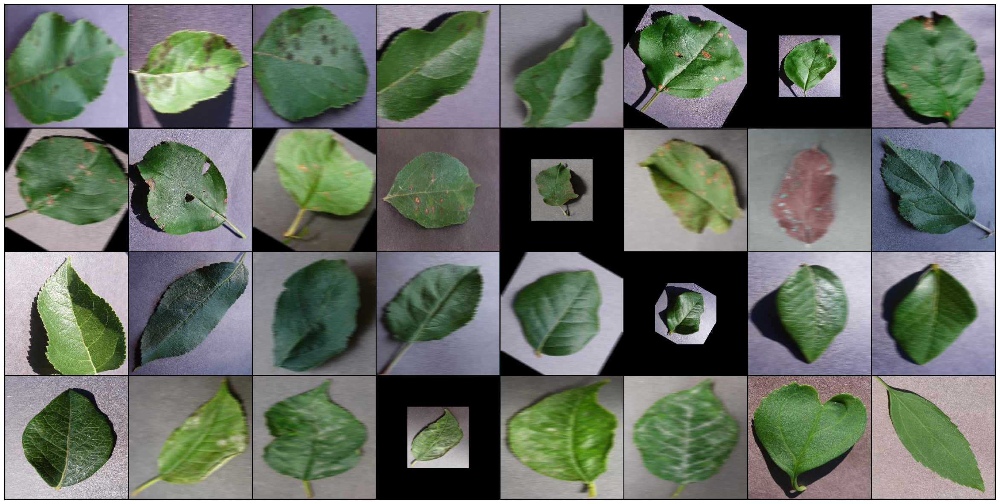

In [ ]:
show_batch(valid_mod_dl)

In [ ]:
valid_mod_dl = DeviceDataLoader(valid_mod_dl, device)

In [ ]:
model = to_device(ResNet9(3, 38), device) 
model

ResNet9(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (res1): Sequential(
    (0): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=Tr

In [ ]:
%%time
history = [evaluate(model, valid_mod_dl)]
history

CPU times: user 468 ms, sys: 155 ms, total: 623 ms
Wall time: 1.5 s


[{'val_loss': tensor(3.6386, device='cuda:0'), 'val_accuracy': tensor(0.0264)}]

In [ ]:
train = ImageFolder(train_dir, transform=transforms.ToTensor())
train_dl = DataLoader(train, batch_size, shuffle=True, num_workers=2, pin_memory=True)
train_dl = DeviceDataLoader(train_dl, device)

In [ ]:
epochs = 1
max_lr = 0.01
grad_clip = 0.1
weight_decay = 1e-4
opt_func = torch.optim.Adam

In [ ]:
%%time
history += fit_OneCycle(epochs, max_lr, model, train_dl, valid_mod_dl, 
                             grad_clip=grad_clip, 
                             weight_decay=1e-4, 
                             opt_func=opt_func)

In [ ]:
plot_accuracies(history)

### **On using the modified dataset as validation dataset, we get a validation accuracy of 53.16%.**

# **How to make the accuracy improve?**

## **Deblurring the Modified Dataset**

### **Using a State-Of-The-Art deblur model: SelfDeblur**

In [ ]:
! git clone https://github.com/ethliup/SelfDeblur.git
%cd ./SelfDeblur/
! pip install -r requirements.txt
%cd ./correlation_package
! python setup.py install
%cd ./reblur_package
! python setup.py install
%cd ..
#put photos in demo/fastec/

fatal: destination path 'SelfDeblur' already exists and is not an empty directory.
/content/SelfDeblur
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement meshzoo==0.4.3 (from versions: 0.9.11, 0.9.12, 0.9.13, 0.9.14, 0.9.15, 0.9.17, 0.9.18, 0.9.19, 0.9.20, 0.11.0, 0.11.1)
ERROR: No matching distribution found for meshzoo==0.4.3
/content/SelfDeblur/correlation_package
running install
/usr/lib/python3.10/distutils/cmd.py:62: SetuptoolsDeprecationWarning: setup.py install is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` directly.
        Instead, use pypa/build, pypa/installer, pypa/build or
        other standards-based tools.

        See https://blog.ganssle.io/articles/2021/10/setup-py-deprecated.html for details.
        *******************************************************

In [ ]:
!bash download_pretrained_models.sh
!bash demo.sh

--2023-05-03 18:09:28--  https://docs.google.com/uc?export=download&id=1VlnQrGMt3gDU4ocTLhIDyndccj30CA1M
Resolving docs.google.com (docs.google.com)... 172.253.62.102, 172.253.62.139, 172.253.62.138, ...
Connecting to docs.google.com (docs.google.com)|172.253.62.102|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0g-54-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/lu2dkknb8n4ehbtoj90oag2ra29qs22j/1683137325000/04499342872852864355/*/1VlnQrGMt3gDU4ocTLhIDyndccj30CA1M?e=download&uuid=5b9db0b3-cbc6-4730-a75a-6bfd8cace66f [following]
--2023-05-03 18:09:29--  https://doc-0g-54-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/lu2dkknb8n4ehbtoj90oag2ra29qs22j/1683137325000/04499342872852864355/*/1VlnQrGMt3gDU4ocTLhIDyndccj30CA1M?e=download&uuid=5b9db0b3-cbc6-4730-a75a-6bfd8cace66f
Resolving doc-0g-54-docs.googleusercontent.com (doc-0g-54-docs.googleusercontent.com)... 172.253.115.132, 2607:f8b0

/content/SelfDeblur/experiments/results_demo_fastec/0000_blur.png
/content/SelfDeblur/experiments/results_demo_fastec/0000_pred.png
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___healthy/4bd918e2-ac0a-41b4-b1a0-f1bb799a309c___RS_HL 9846.JPG
/content/SelfDeblur/demo/fastec/4bd918e2-ac0a-41b4-b1a0-f1bb799a309c___RS_HL 9846.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_

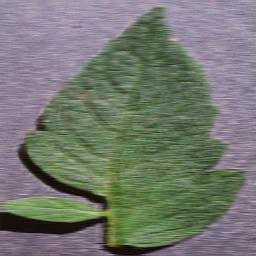

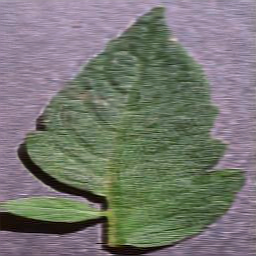

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___healthy/45167988-3f78-4309-8ce2-633d7521847f___GH_HL Leaf 432.1.JPG
/content/SelfDeblur/demo/fastec/4bd918e2-ac0a-41b4-b1a0-f1bb799a309c___RS_HL 9846.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (conv

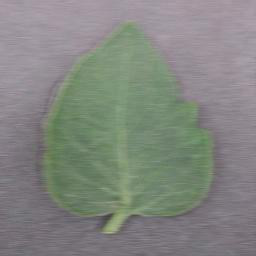

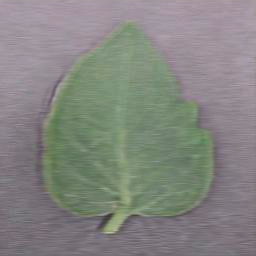

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___healthy/efe02473-2f94-4ff5-a478-cc9d8ebd79da___RS_HL 9671.JPG
/content/SelfDeblur/demo/fastec/45167988-3f78-4309-8ce2-633d7521847f___GH_HL Leaf 432.1.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (conv

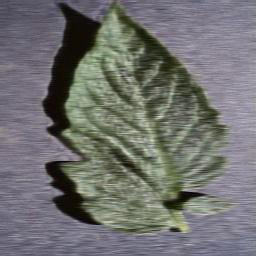

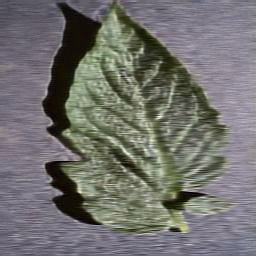

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___healthy/6b53630d-c9df-4e67-a490-b1835772d9a0___GH_HL Leaf 450.2.JPG
/content/SelfDeblur/demo/fastec/efe02473-2f94-4ff5-a478-cc9d8ebd79da___RS_HL 9671.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (conv

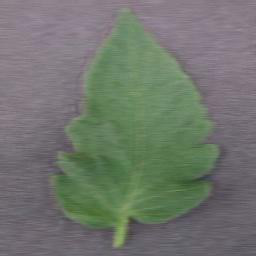

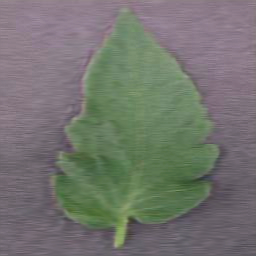

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___healthy/3ea001ac-b49b-4382-a95d-a602fba00a5a___GH_HL Leaf 445.JPG
/content/SelfDeblur/demo/fastec/6b53630d-c9df-4e67-a490-b1835772d9a0___GH_HL Leaf 450.2.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (

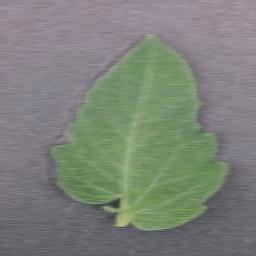

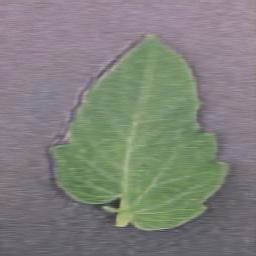

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/1b567c7d-1041-4240-a56c-8ea94e6252b4___FREC_C.Rust 4245_270deg.JPG
/content/SelfDeblur/demo/fastec/3ea001ac-b49b-4382-a95d-a602fba00a5a___GH_HL Leaf 445.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_b

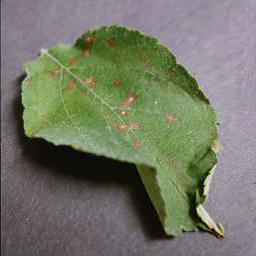

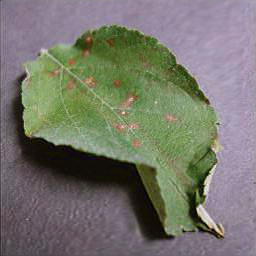

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/0a41c25a-f9a6-4c34-8e5c-7f89a6ac4c40___FREC_C.Rust 9807_new30degFlipTB.JPG
/content/SelfDeblur/demo/fastec/1b567c7d-1041-4240-a56c-8ea94e6252b4___FREC_C.Rust 4245_270deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
  

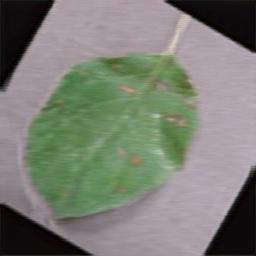

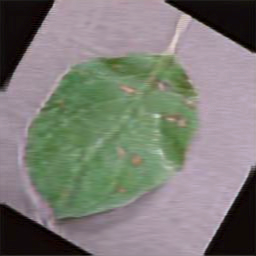

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/70190de6-c93f-4b1e-9c6d-19b0b424f42f___FREC_C.Rust 4315_newGRR.JPG
/content/SelfDeblur/demo/fastec/0a41c25a-f9a6-4c34-8e5c-7f89a6ac4c40___FREC_C.Rust 9807_new30degFlipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
  

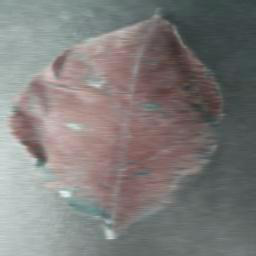

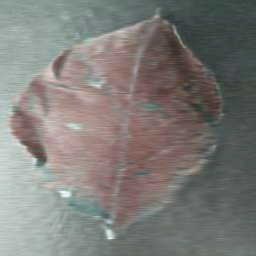

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/20ef08f2-96ae-4148-942c-3d7708cd94d8___FREC_C.Rust 9830_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/70190de6-c93f-4b1e-9c6d-19b0b424f42f___FREC_C.Rust 4315_newGRR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
  

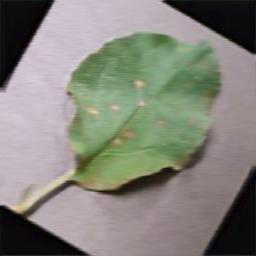

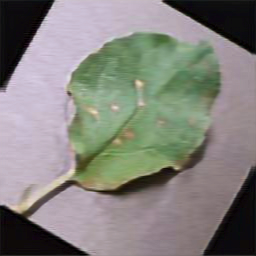

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/ea119d19-1b3a-4767-af1d-e8b148a3bb8d___FREC_C.Rust 3579.JPG
/content/SelfDeblur/demo/fastec/20ef08f2-96ae-4148-942c-3d7708cd94d8___FREC_C.Rust 9830_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1)

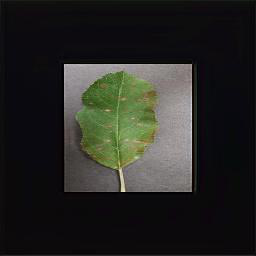

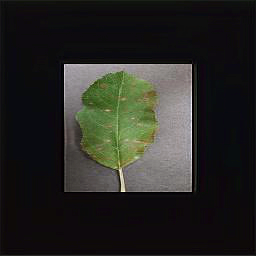

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Early_blight/8714986a-ae97-489a-8259-67411bfa2379___RS_Erly.B 9400_flipTB.JPG
/content/SelfDeblur/demo/fastec/ea119d19-1b3a-4767-af1d-e8b148a3bb8d___FREC_C.Rust 3579.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bloc

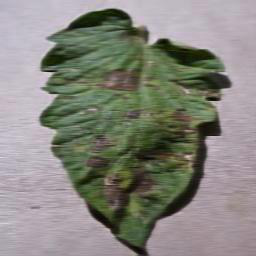

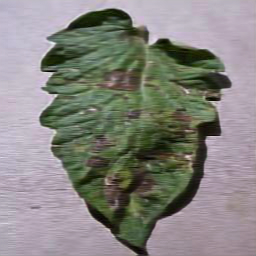

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Early_blight/dc6eeebe-ebc4-406c-b5df-f4861f491db8___RS_Erly.B 9615_180deg.JPG
/content/SelfDeblur/demo/fastec/8714986a-ae97-489a-8259-67411bfa2379___RS_Erly.B 9400_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet

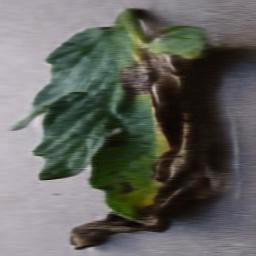

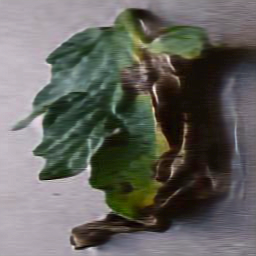

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Early_blight/886b8bc5-3690-4939-b5d5-066c7e62019d___RS_Erly.B 9454.JPG
/content/SelfDeblur/demo/fastec/dc6eeebe-ebc4-406c-b5df-f4861f491db8___RS_Erly.B 9615_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(

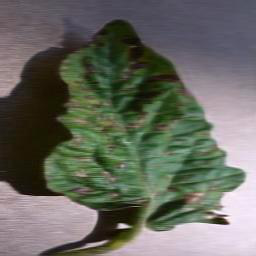

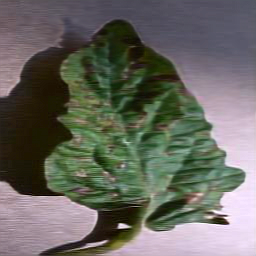

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Early_blight/bbaa5bf2-ded0-422a-babb-350da80266a9___RS_Erly.B 7575.JPG
/content/SelfDeblur/demo/fastec/886b8bc5-3690-4939-b5d5-066c7e62019d___RS_Erly.B 9454.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
      

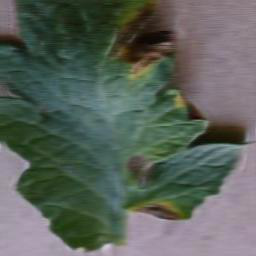

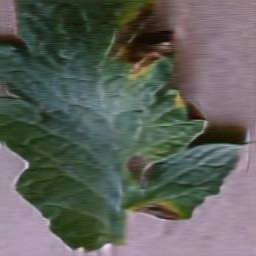

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Early_blight/3592b22c-09cd-4005-97c4-cdd11318cce0___RS_Erly.B 9391_flipTB.JPG
/content/SelfDeblur/demo/fastec/bbaa5bf2-ded0-422a-babb-350da80266a9___RS_Erly.B 7575.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(

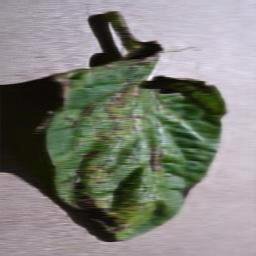

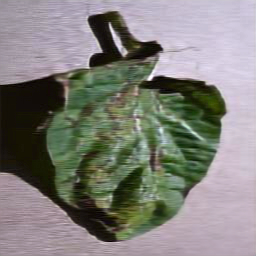

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/6f65ae2d-7b09-4774-adfc-2742a4fbdbe4___Mary_HL 9240_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/3592b22c-09cd-4005-97c4-cdd11318cce0___RS_Erly.B 9391_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Re

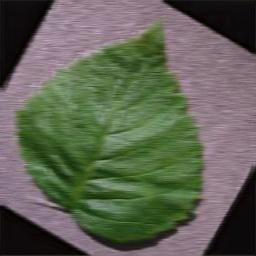

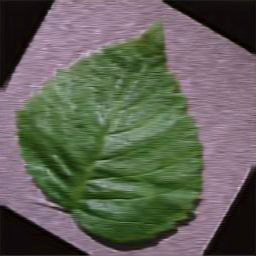

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/5a59cfb6-8600-40d5-bf8c-3bb8a30422b9___Mary_HL 6252_180deg.JPG
/content/SelfDeblur/demo/fastec/6f65ae2d-7b09-4774-adfc-2742a4fbdbe4___Mary_HL 9240_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resn

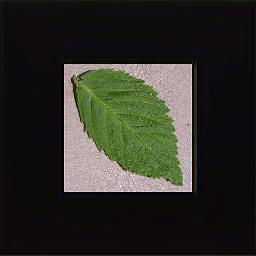

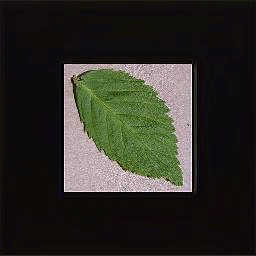

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/e6914eed-6170-4d2f-98d6-390a1c8600f2___Mary_HL 6297_270deg.JPG
/content/SelfDeblur/demo/fastec/5a59cfb6-8600-40d5-bf8c-3bb8a30422b9___Mary_HL 6252_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

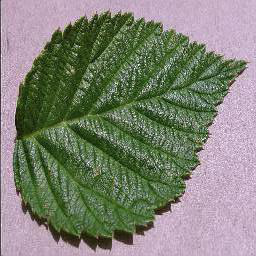

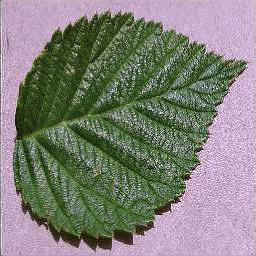

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/0f9c8b1e-e13d-4db8-bd39-6f9ce73b244d___Mary_HL 6409_270deg.JPG
/content/SelfDeblur/demo/fastec/e6914eed-6170-4d2f-98d6-390a1c8600f2___Mary_HL 6297_270deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

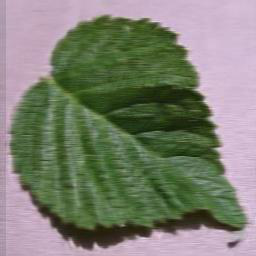

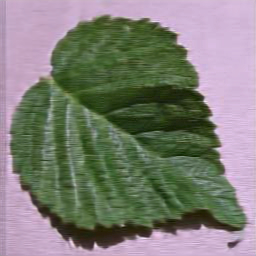

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/6c5efa45-6834-4b2d-8c2c-e24153cc20fc___Mary_HL 6227.JPG
/content/SelfDeblur/demo/fastec/0f9c8b1e-e13d-4db8-bd39-6f9ce73b244d___Mary_HL 6409_270deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

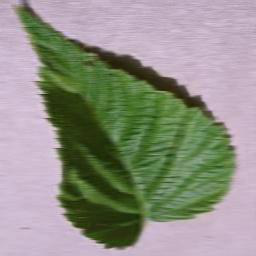

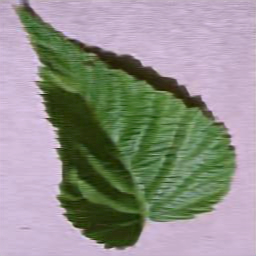

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot/c4bd1ca9-533e-4a74-a4d1-8d633ac76438___RS_GLSp 4318_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/6c5efa45-6834-4b2d-8c2c-e24153cc20fc___Mary_HL 6227.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )

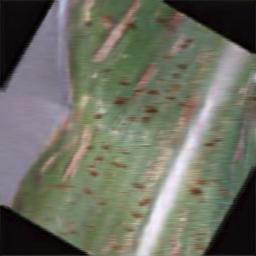

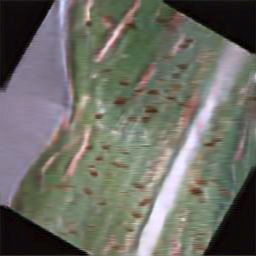

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot/2a2ad0a4-9f19-4366-88d3-c1c87ffc9f90___RS_GLSp 4385_270deg.JPG
/content/SelfDeblur/demo/fastec/c4bd1ca9-533e-4a74-a4d1-8d633ac76438___RS_GLSp 4318_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
  

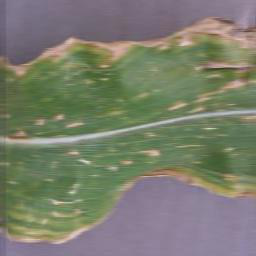

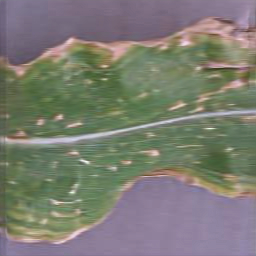

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot/06e94cd0-fe77-4af0-b4ae-664fcd78cfff___RS_GLSp 4656_90deg.JPG
/content/SelfDeblur/demo/fastec/2a2ad0a4-9f19-4366-88d3-c1c87ffc9f90___RS_GLSp 4385_270deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
 

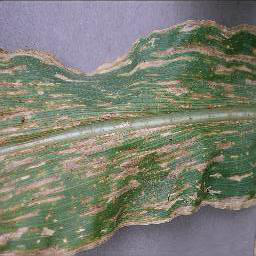

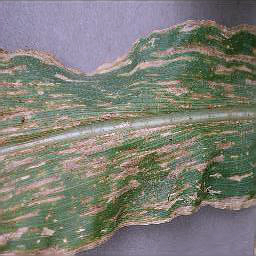

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot/75c57507-6463-4886-8195-b1319c434ef7___RS_GLSp 4390_90deg.JPG
/content/SelfDeblur/demo/fastec/06e94cd0-fe77-4af0-b4ae-664fcd78cfff___RS_GLSp 4656_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
  

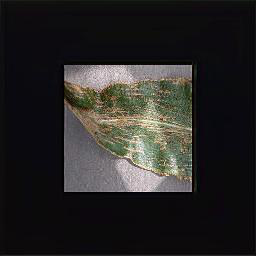

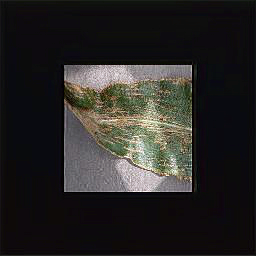

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot/d1f9878a-eea5-4008-8a1d-b3a88e2654b8___RS_GLSp 4640_90deg.JPG
/content/SelfDeblur/demo/fastec/75c57507-6463-4886-8195-b1319c434ef7___RS_GLSp 4390_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
  

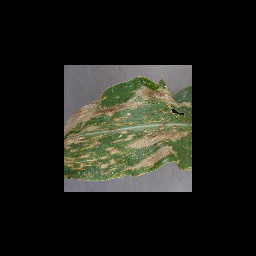

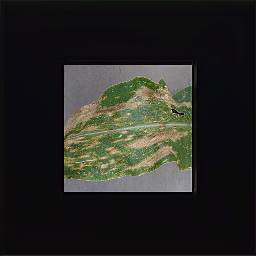

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/ae72095b-62bd-4930-b83c-ef4d8264f437___RS_NLB 3895_flipTB.JPG
/content/SelfDeblur/demo/fastec/d1f9878a-eea5-4008-8a1d-b3a88e2654b8___RS_GLSp 4640_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1)

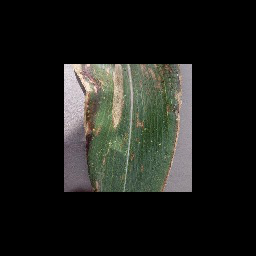

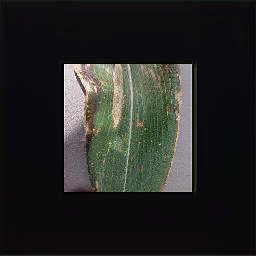

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/6313736d-ff6e-4180-8f38-8c9e635d9da9___RS_NLB 3865.JPG
/content/SelfDeblur/demo/fastec/ae72095b-62bd-4930-b83c-ef4d8264f437___RS_NLB 3895_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

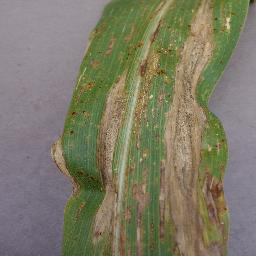

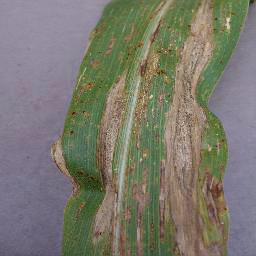

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/474797d0-3298-4480-ba05-7c49026ffbbf___RS_NLB 3529_flipTB.JPG
/content/SelfDeblur/demo/fastec/6313736d-ff6e-4180-8f38-8c9e635d9da9___RS_NLB 3865.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

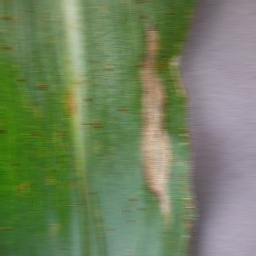

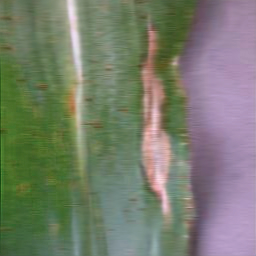

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/772c92e7-3535-4f03-a85b-67b843123079___RS_NLB 4125_flipTB.JPG
/content/SelfDeblur/demo/fastec/474797d0-3298-4480-ba05-7c49026ffbbf___RS_NLB 3529_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1)

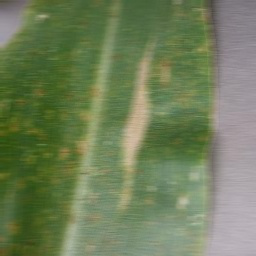

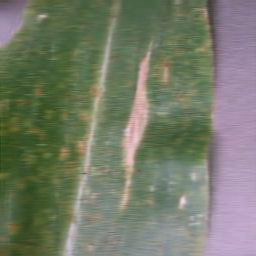

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/c58adcec-6938-4e1b-9a47-5b09f8d4e0b1___RS_NLB 4147.JPG
/content/SelfDeblur/demo/fastec/772c92e7-3535-4f03-a85b-67b843123079___RS_NLB 4125_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

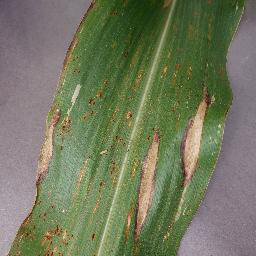

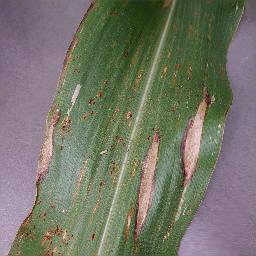

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Tomato_mosaic_virus/55117128-4dcf-4b3a-bde6-9f42a18d4b24___PSU_CG 2377.JPG
/content/SelfDeblur/demo/fastec/c58adcec-6938-4e1b-9a47-5b09f8d4e0b1___RS_NLB 4147.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

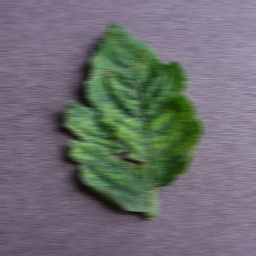

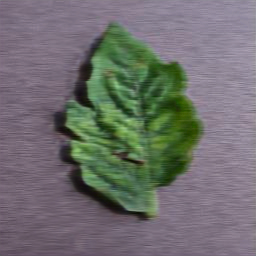

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Tomato_mosaic_virus/763335af-2beb-4331-b2e5-3f61a4b0b914___PSU_CG 2365_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/55117128-4dcf-4b3a-bde6-9f42a18d4b24___PSU_CG 2377.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resn

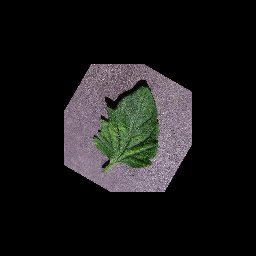

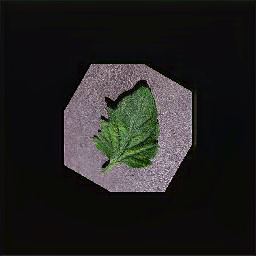

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Tomato_mosaic_virus/503c6a57-2af3-48ed-b96f-e2cbf6fb5dd1___PSU_CG 2263_newPixel25.JPG
/content/SelfDeblur/demo/fastec/763335af-2beb-4331-b2e5-3f61a4b0b914___PSU_CG 2365_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
    

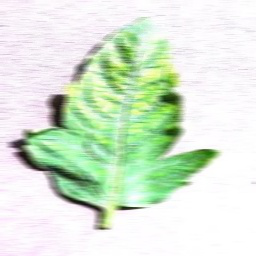

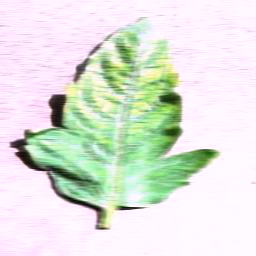

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Tomato_mosaic_virus/b32647fc-d502-4bb4-99f6-3003874daee4___PSU_CG 2246_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/503c6a57-2af3-48ed-b96f-e2cbf6fb5dd1___PSU_CG 2263_newPixel25.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
    

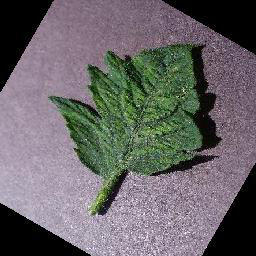

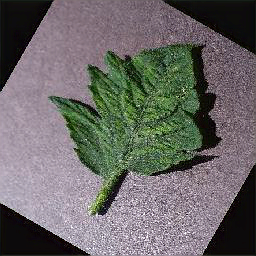

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Tomato_mosaic_virus/f404ec4e-80d9-4392-900e-43a28f689145___PSU_CG 2323_90deg.JPG
/content/SelfDeblur/demo/fastec/b32647fc-d502-4bb4-99f6-3003874daee4___PSU_CG 2246_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1)

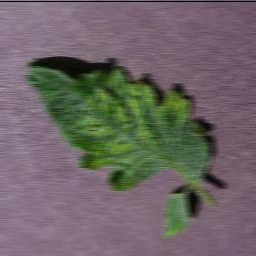

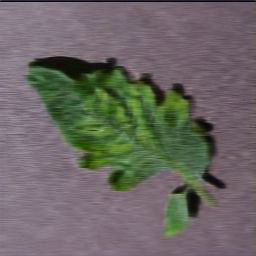

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Cherry_(including_sour)___healthy/75435566-6073-4f71-9376-0fe7e4598ae9___JR_HL 9636_flipTB.JPG
/content/SelfDeblur/demo/fastec/f404ec4e-80d9-4392-900e-43a28f689145___PSU_CG 2323_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Re

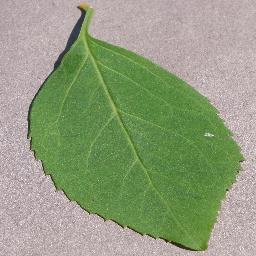

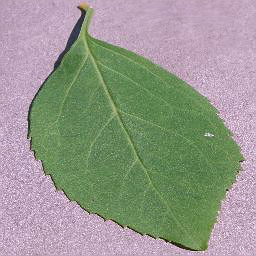

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Cherry_(including_sour)___healthy/fc9a5244-238a-4e19-9e07-80819941f414___JR_HL 4006_flipTB.JPG
/content/SelfDeblur/demo/fastec/75435566-6073-4f71-9376-0fe7e4598ae9___JR_HL 9636_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Re

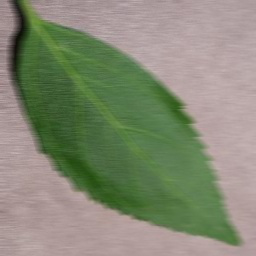

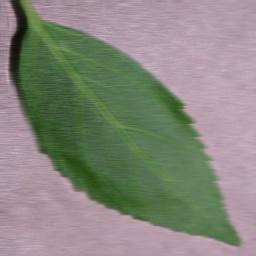

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Cherry_(including_sour)___healthy/97df0152-e34f-4b34-bb2e-b2d9aadb19ee___JR_HL 4209.JPG
/content/SelfDeblur/demo/fastec/fc9a5244-238a-4e19-9e07-80819941f414___JR_HL 4006_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bl

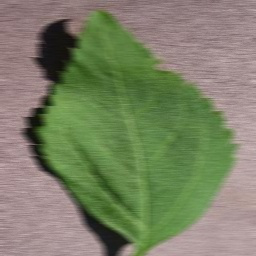

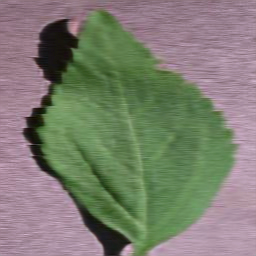

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Cherry_(including_sour)___healthy/c3101d4e-19b3-4959-92a4-b1b8c88d0bec___JR_HL 3994_180deg.JPG
/content/SelfDeblur/demo/fastec/97df0152-e34f-4b34-bb2e-b2d9aadb19ee___JR_HL 4209.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bl

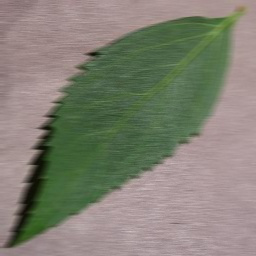

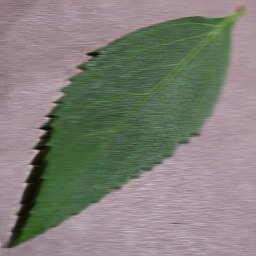

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Cherry_(including_sour)___healthy/ac392c19-68f4-41aa-9923-2be5483a0b4c___JR_HL 9802_flipTB.JPG
/content/SelfDeblur/demo/fastec/c3101d4e-19b3-4959-92a4-b1b8c88d0bec___JR_HL 3994_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Re

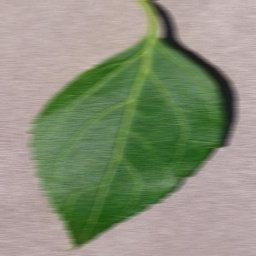

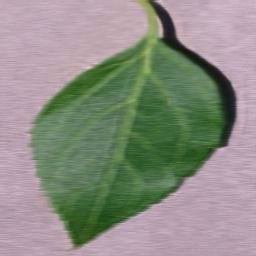

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Strawberry___healthy/fb8db167-dda8-4bda-99a5-d7b688b14e89___RS_HL 4442_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/ac392c19-68f4-41aa-9923-2be5483a0b4c___JR_HL 9802_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_

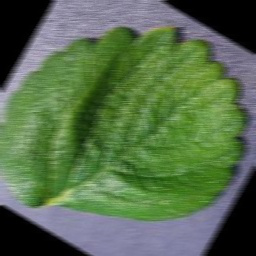

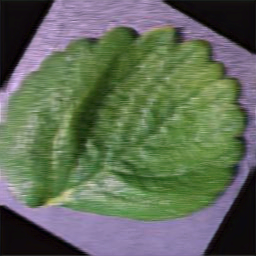

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Strawberry___healthy/00532378-bfb2-4d3b-8b19-903ecc085624___RS_HL 2021_90deg.JPG
/content/SelfDeblur/demo/fastec/fb8db167-dda8-4bda-99a5-d7b688b14e89___RS_HL 4442_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_b

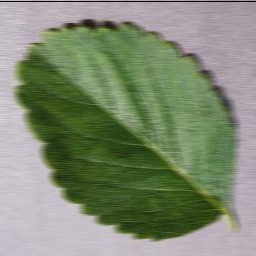

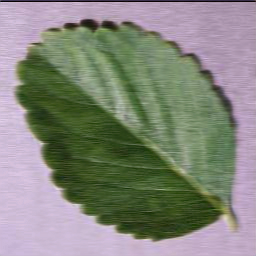

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Strawberry___healthy/4abe583a-841b-4173-98d5-548dcbc16275___RS_HL 2129_90deg.JPG
/content/SelfDeblur/demo/fastec/00532378-bfb2-4d3b-8b19-903ecc085624___RS_HL 2021_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
   

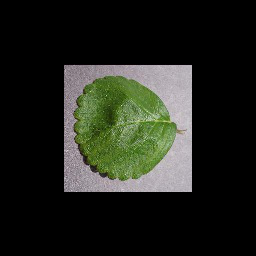

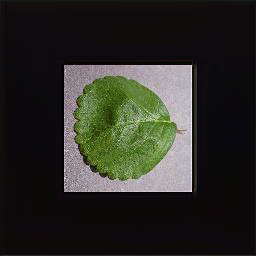

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Strawberry___healthy/577164f8-3653-4347-a51e-ac0f67ef5a43___RS_HL 2158_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/4abe583a-841b-4173-98d5-548dcbc16275___RS_HL 2129_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_b

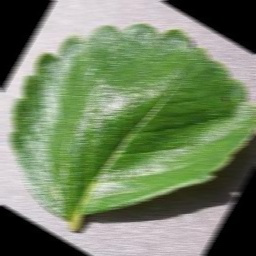

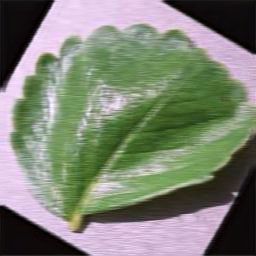

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Strawberry___healthy/60646de2-333f-40b6-bdf9-f0d1d0e91271___RS_HL 4795_90deg.JPG
/content/SelfDeblur/demo/fastec/577164f8-3653-4347-a51e-ac0f67ef5a43___RS_HL 2158_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_b

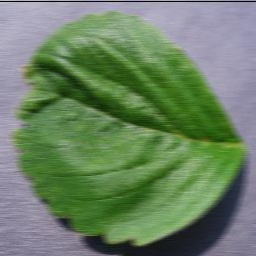

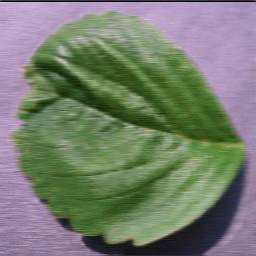

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Apple_scab/b3b884bb-55ff-42dd-81d6-d8260acd4ad5___FREC_Scab 3281_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/60646de2-333f-40b6-bdf9-f0d1d0e91271___RS_HL 4795_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet

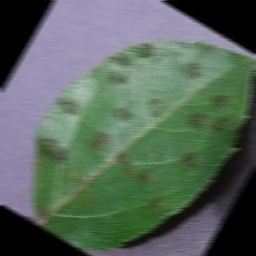

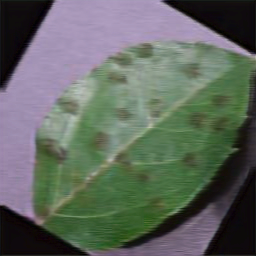

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Apple_scab/15bfa086-7d4a-43c0-800d-2fe8255ba50c___FREC_Scab 3150.JPG
/content/SelfDeblur/demo/fastec/b3b884bb-55ff-42dd-81d6-d8260acd4ad5___FREC_Scab 3281_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_b

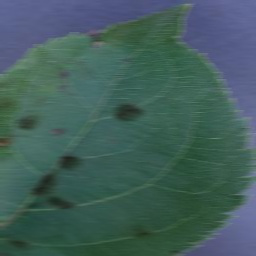

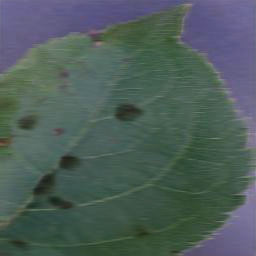

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Apple_scab/afab688d-242c-4e62-abef-ba277df5a76d___FREC_Scab 3188_90deg.JPG
/content/SelfDeblur/demo/fastec/15bfa086-7d4a-43c0-800d-2fe8255ba50c___FREC_Scab 3150.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
   

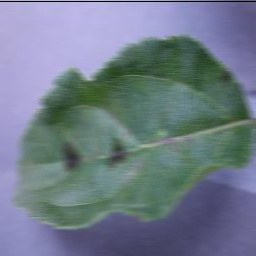

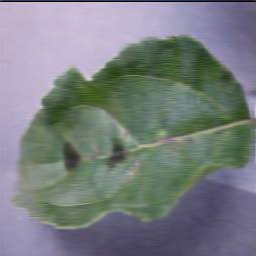

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Apple_scab/f957b91b-878a-4f53-b8b5-a8bf7fa2c773___FREC_Scab 2970_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/afab688d-242c-4e62-abef-ba277df5a76d___FREC_Scab 3188_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Re

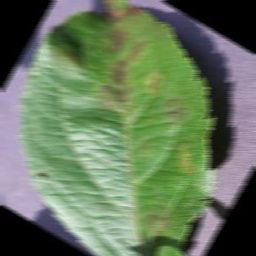

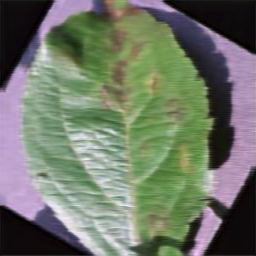

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Apple_scab/a7609a35-fd75-4ec3-868a-eb97b9ffd096___FREC_Scab 3032_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/f957b91b-878a-4f53-b8b5-a8bf7fa2c773___FREC_Scab 2970_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
    

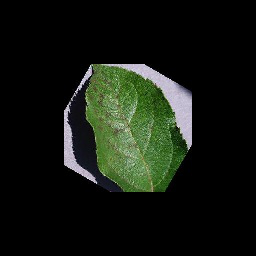

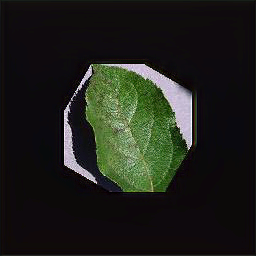

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___healthy/c85bacb0-e5e8-4127-a0b0-a7342f2cab5f___RS_HL 5406_new90degFlipTB.JPG
/content/SelfDeblur/demo/fastec/a7609a35-fd75-4ec3-868a-eb97b9ffd096___FREC_Scab 3032_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

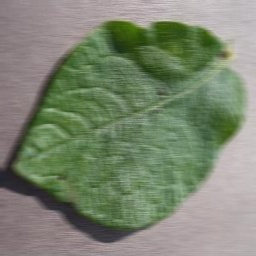

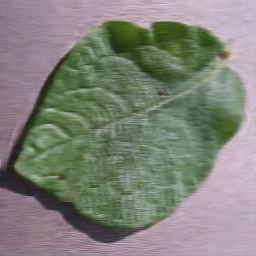

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___healthy/7e7b6ab4-9adb-4a3b-abfb-8716b0039879___RS_HL 1921_new200degFlipLR.JPG
/content/SelfDeblur/demo/fastec/c85bacb0-e5e8-4127-a0b0-a7342f2cab5f___RS_HL 5406_new90degFlipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Re

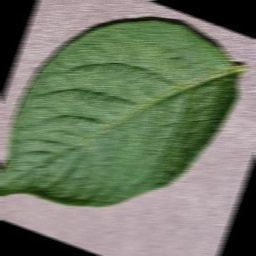

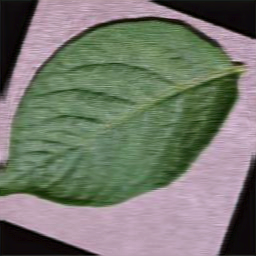

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___healthy/3edf7c3f-73e0-439c-870d-76cfd7c3bc45___RS_HL 1859_flipTB.JPG
/content/SelfDeblur/demo/fastec/7e7b6ab4-9adb-4a3b-abfb-8716b0039879___RS_HL 1921_new200degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_blo

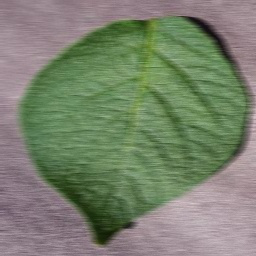

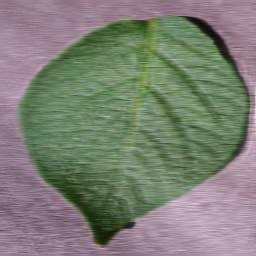

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___healthy/43fd6ace-3712-494a-9aba-de5482d22561___RS_HL 1968_newPixel25.JPG
/content/SelfDeblur/demo/fastec/3edf7c3f-73e0-439c-870d-76cfd7c3bc45___RS_HL 1859_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
 

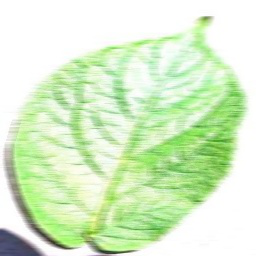

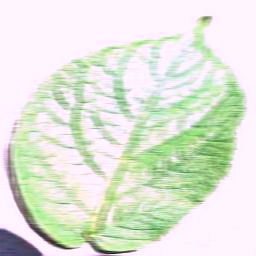

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___healthy/00fc2ee5-729f-4757-8aeb-65c3355874f2___RS_HL 1864_newGRR.JPG
/content/SelfDeblur/demo/fastec/43fd6ace-3712-494a-9aba-de5482d22561___RS_HL 1968_newPixel25.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
 

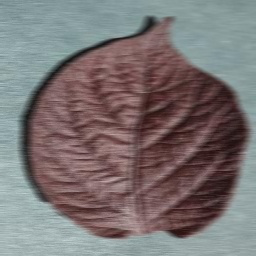

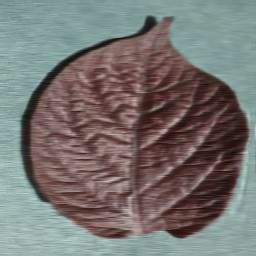

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___healthy/56e3464d-39d5-4694-b34a-2af5866c949a___R.S_HL 5563 copy.jpg
/content/SelfDeblur/demo/fastec/00fc2ee5-729f-4757-8aeb-65c3355874f2___RS_HL 1864_newGRR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(


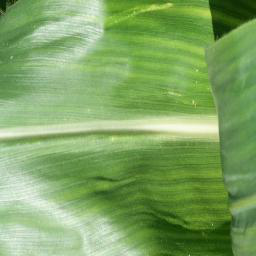

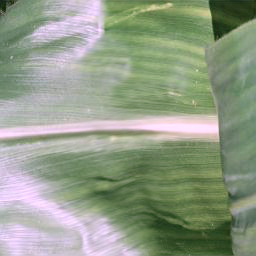

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___healthy/be7c9d7f-2a89-4364-9173-76eecdd3d29e___R.S_HL 8298 copy.jpg
/content/SelfDeblur/demo/fastec/56e3464d-39d5-4694-b34a-2af5866c949a___R.S_HL 5563 copy.jpg
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
 

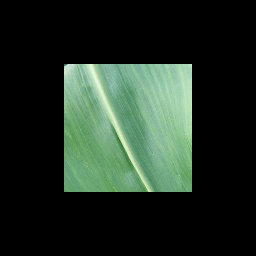

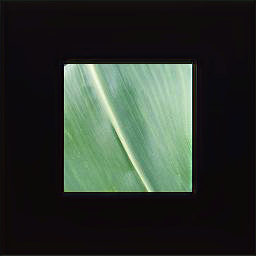

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___healthy/a599c53f-dd93-4629-b2b4-0b16c9714bd8___R.S_HL 7963 copy_flipLR.jpg
/content/SelfDeblur/demo/fastec/be7c9d7f-2a89-4364-9173-76eecdd3d29e___R.S_HL 8298 copy.jpg
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_b

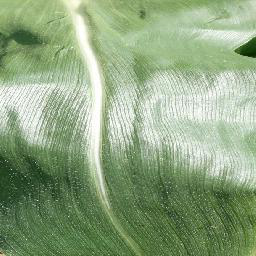

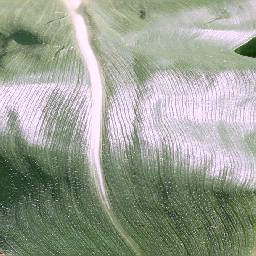

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___healthy/1d60142d-84cb-418d-9017-cb443a63bf3a___R.S_HL 7896 copy 3_flipLR.jpg
/content/SelfDeblur/demo/fastec/a599c53f-dd93-4629-b2b4-0b16c9714bd8___R.S_HL 7963 copy_flipLR.jpg
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

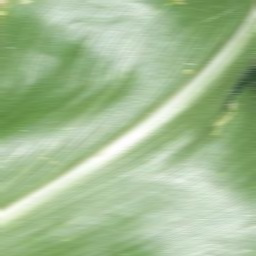

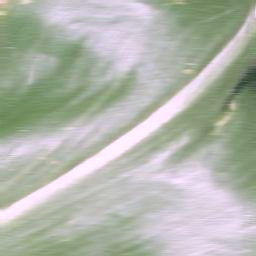

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___healthy/b27ca23d-e90c-4087-8421-dec6e1876c89___R.S_HL 8075 copy.jpg
/content/SelfDeblur/demo/fastec/1d60142d-84cb-418d-9017-cb443a63bf3a___R.S_HL 7896 copy 3_flipLR.jpg
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet

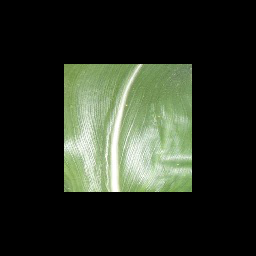

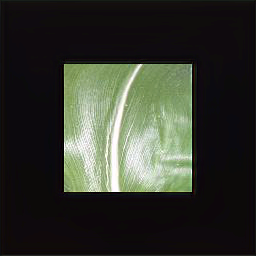

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Septoria_leaf_spot/87e254da-f3ea-4127-9a08-ed12180da6de___Matt.S_CG 6334.JPG
/content/SelfDeblur/demo/fastec/b27ca23d-e90c-4087-8421-dec6e1876c89___R.S_HL 8075 copy.jpg
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

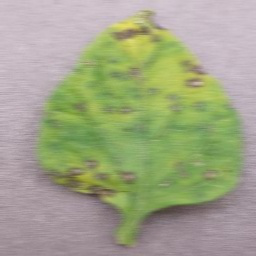

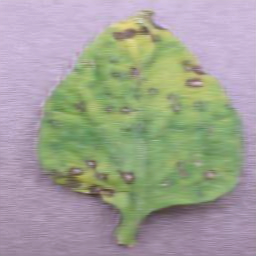

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Septoria_leaf_spot/862cca81-2acd-4a2b-89aa-bd01d9524d7b___JR_Sept.L.S 2577.JPG
/content/SelfDeblur/demo/fastec/87e254da-f3ea-4127-9a08-ed12180da6de___Matt.S_CG 6334.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

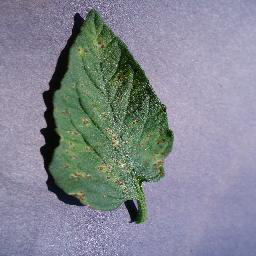

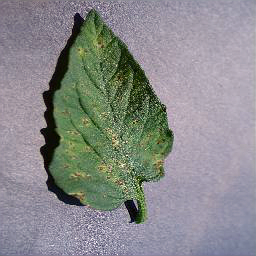

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Septoria_leaf_spot/8ddb1dc4-2a3b-47d1-aff4-53272713f514___JR_Sept.L.S 2603.JPG
/content/SelfDeblur/demo/fastec/862cca81-2acd-4a2b-89aa-bd01d9524d7b___JR_Sept.L.S 2577.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_blo

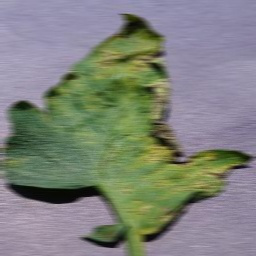

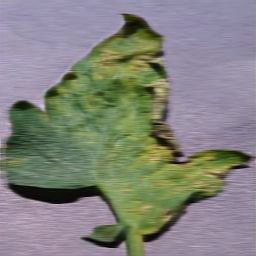

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Septoria_leaf_spot/2097ad9f-76af-47d8-b6f4-232437ba1f87___Matt.S_CG 1240.JPG
/content/SelfDeblur/demo/fastec/8ddb1dc4-2a3b-47d1-aff4-53272713f514___JR_Sept.L.S 2603.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

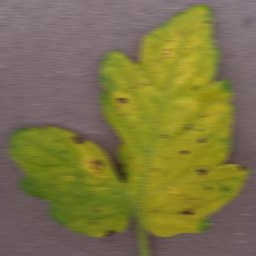

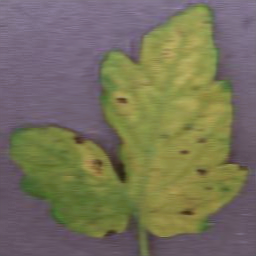

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Septoria_leaf_spot/45c3dbbf-94eb-4e9e-9f09-b93609f6db7d___JR_Sept.L.S 2543.JPG
/content/SelfDeblur/demo/fastec/2097ad9f-76af-47d8-b6f4-232437ba1f87___Matt.S_CG 1240.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

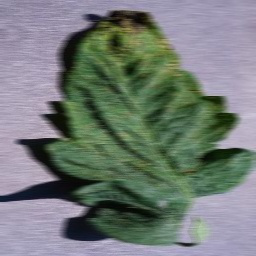

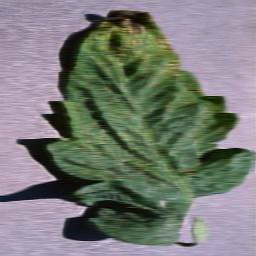

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/301b41f3-647f-4bd2-9adb-ef98c8b8c238___JR_B.Spot 3399_flipTB.JPG
/content/SelfDeblur/demo/fastec/45c3dbbf-94eb-4e9e-9f09-b93609f6db7d___JR_Sept.L.S 2543.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Res

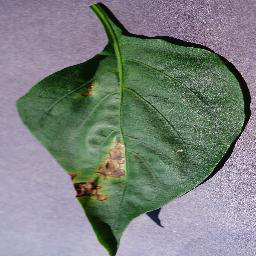

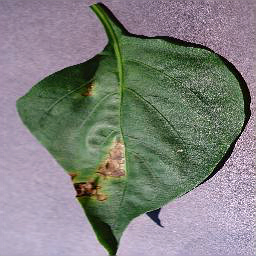

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/a9770664-3c9c-46ed-808d-5aa7a87a5c1b___NREC_B.Spot 9065_flipTB.JPG
/content/SelfDeblur/demo/fastec/301b41f3-647f-4bd2-9adb-ef98c8b8c238___JR_B.Spot 3399_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (

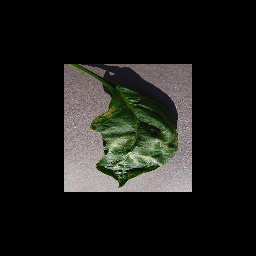

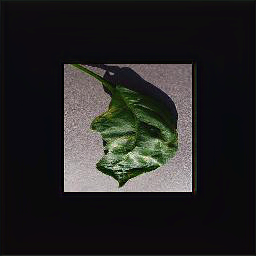

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/97fa8b63-1a92-4760-802c-2acfecc67e65___JR_B.Spot 8827_flipTB.JPG
/content/SelfDeblur/demo/fastec/a9770664-3c9c-46ed-808d-5aa7a87a5c1b___NREC_B.Spot 9065_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (

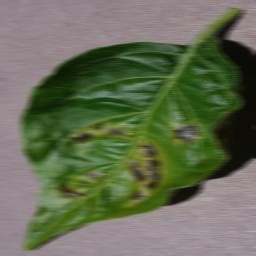

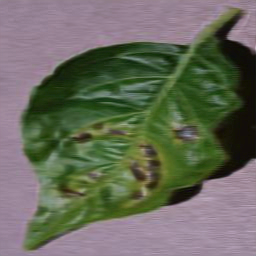

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/055a84c4-8286-4b44-816a-66b82d3bd4bc___NREC_B.Spot 9105.JPG
/content/SelfDeblur/demo/fastec/97fa8b63-1a92-4760-802c-2acfecc67e65___JR_B.Spot 8827_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Res

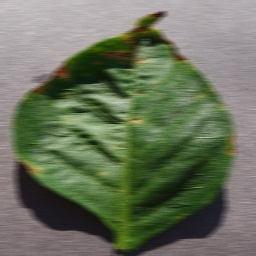

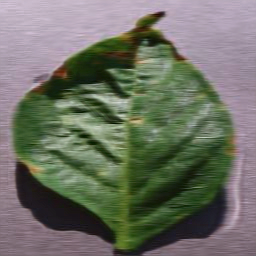

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/da3fdd83-69de-4688-8386-71e01138f324___JR_B.Spot 8994.JPG
/content/SelfDeblur/demo/fastec/055a84c4-8286-4b44-816a-66b82d3bd4bc___NREC_B.Spot 9105.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_blo

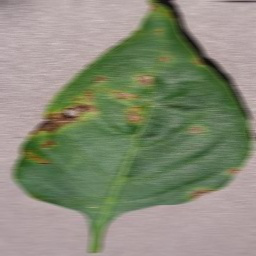

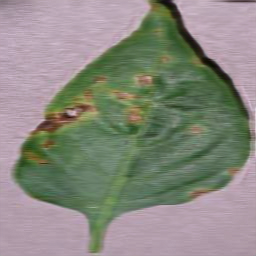

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/f9abf8f6-7783-473c-81d2-a84dba013d3e___Rutg._HL 2500_90deg.JPG
/content/SelfDeblur/demo/fastec/da3fdd83-69de-4688-8386-71e01138f324___JR_B.Spot 8994.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
       

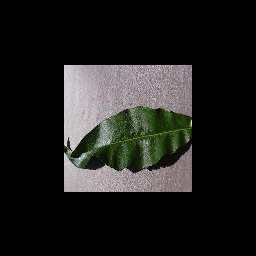

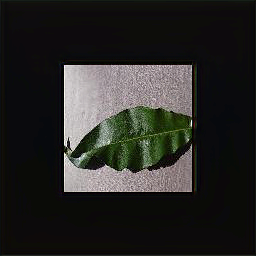

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/351fa63d-34fc-4cfc-bfd0-437387c63973___Rutg._HL 3694_270deg.JPG
/content/SelfDeblur/demo/fastec/f9abf8f6-7783-473c-81d2-a84dba013d3e___Rutg._HL 2500_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
 

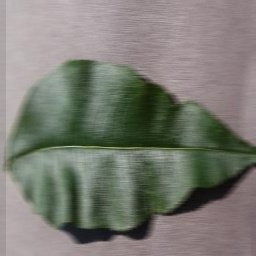

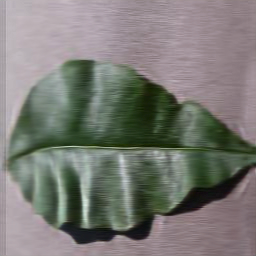

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/c74b63a8-1ca9-4555-bbd6-9d5e70100919___Rutg._HL 3536.JPG
/content/SelfDeblur/demo/fastec/351fa63d-34fc-4cfc-bfd0-437387c63973___Rutg._HL 3694_270deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
       

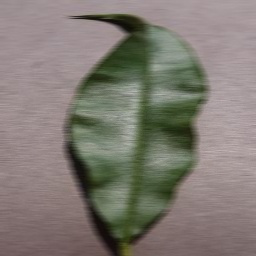

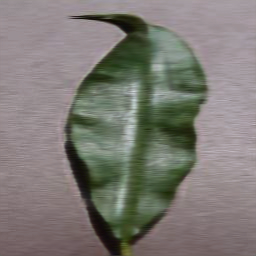

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/0a4795b0-5144-4dea-a7ed-b6243416e8d0___Rutg._HL 3530_90deg.JPG
/content/SelfDeblur/demo/fastec/c74b63a8-1ca9-4555-bbd6-9d5e70100919___Rutg._HL 3536.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        

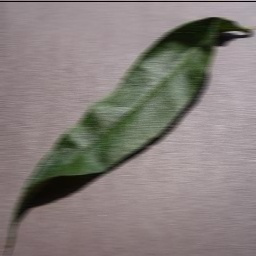

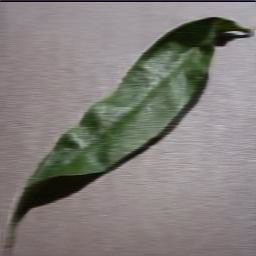

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/7a42f00f-0b6f-48f4-ada5-569fb12ce8f7___Rutg._HL 3682.JPG
/content/SelfDeblur/demo/fastec/0a4795b0-5144-4dea-a7ed-b6243416e8d0___Rutg._HL 3530_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        

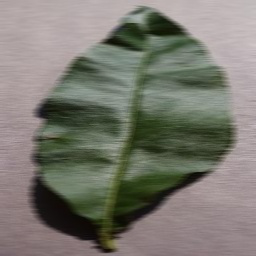

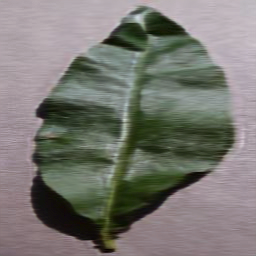

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Tomato_Yellow_Leaf_Curl_Virus/254071ba-5724-485b-855e-8dcc496f3586___YLCV_NREC 2637.JPG
/content/SelfDeblur/demo/fastec/7a42f00f-0b6f-48f4-ada5-569fb12ce8f7___Rutg._HL 3682.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resn

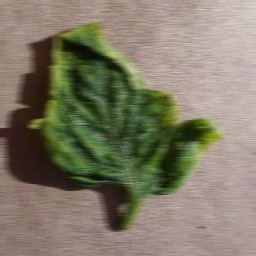

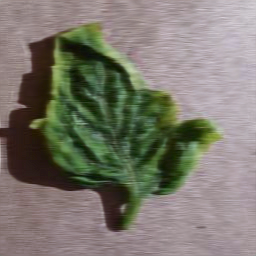

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Tomato_Yellow_Leaf_Curl_Virus/b1db6ecd-197e-40fa-9abb-bce650f2517d___UF.GRC_YLCV_Lab 03221.JPG
/content/SelfDeblur/demo/fastec/254071ba-5724-485b-855e-8dcc496f3586___YLCV_NREC 2637.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (

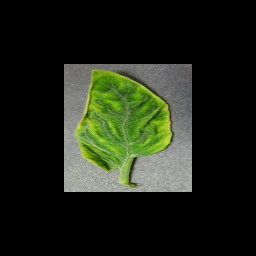

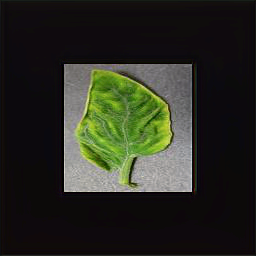

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Tomato_Yellow_Leaf_Curl_Virus/e4431f36-5b30-4420-aed2-9449f0d8ebbb___UF.GRC_YLCV_Lab 09466.JPG
/content/SelfDeblur/demo/fastec/b1db6ecd-197e-40fa-9abb-bce650f2517d___UF.GRC_YLCV_Lab 03221.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )


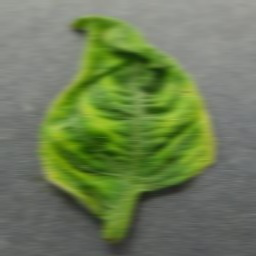

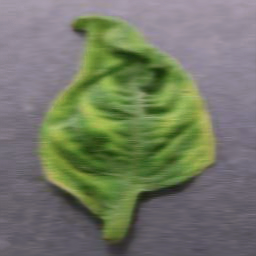

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Tomato_Yellow_Leaf_Curl_Virus/f95286f6-b871-4797-84f4-8bef763654d4___UF.GRC_YLCV_Lab 01847.JPG
/content/SelfDeblur/demo/fastec/e4431f36-5b30-4420-aed2-9449f0d8ebbb___UF.GRC_YLCV_Lab 09466.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )


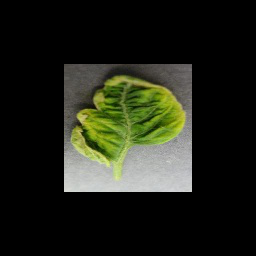

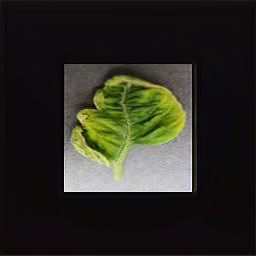

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Tomato_Yellow_Leaf_Curl_Virus/db1391d0-e8ca-45b9-abc3-a80dca761167___YLCV_NREC 2777.JPG
/content/SelfDeblur/demo/fastec/f95286f6-b871-4797-84f4-8bef763654d4___UF.GRC_YLCV_Lab 01847.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (

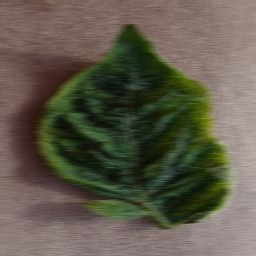

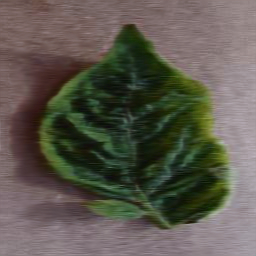

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/bffaf3b2-61c2-43e1-bfec-a3412b3d5ac8___Crnl_L.Mold 7026.JPG
/content/SelfDeblur/demo/fastec/db1391d0-e8ca-45b9-abc3-a80dca761167___YLCV_NREC 2777.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
       

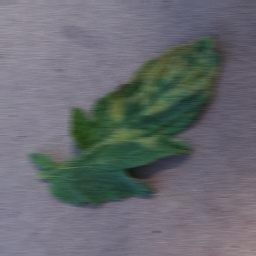

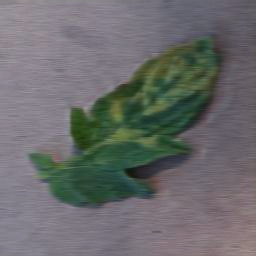

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/59b7a40e-6049-424d-a05e-21a16570f170___Crnl_L.Mold 9153_180deg.JPG
/content/SelfDeblur/demo/fastec/bffaf3b2-61c2-43e1-bfec-a3412b3d5ac8___Crnl_L.Mold 7026.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

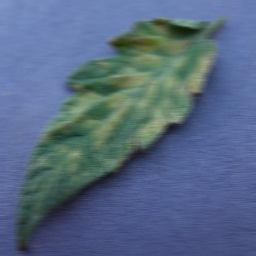

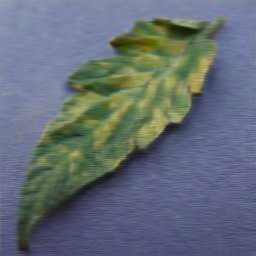

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/605aacc9-f599-4bef-a53c-01e56dde4892___Crnl_L.Mold 8679_flipTB.JPG
/content/SelfDeblur/demo/fastec/59b7a40e-6049-424d-a05e-21a16570f170___Crnl_L.Mold 9153_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

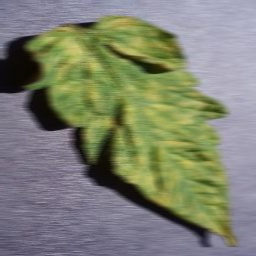

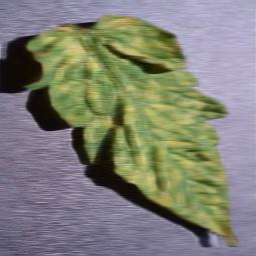

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/a5639de3-303c-4066-b3a0-a72aa73ef818___Crnl_L.Mold 6740_180deg.JPG
/content/SelfDeblur/demo/fastec/605aacc9-f599-4bef-a53c-01e56dde4892___Crnl_L.Mold 8679_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

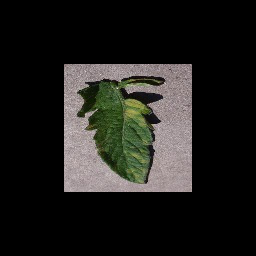

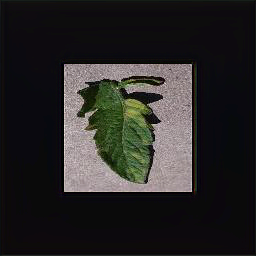

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/329f2f31-ceca-402f-a007-21d64fe75f5e___Crnl_L.Mold 6519_180deg.JPG
/content/SelfDeblur/demo/fastec/a5639de3-303c-4066-b3a0-a72aa73ef818___Crnl_L.Mold 6740_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

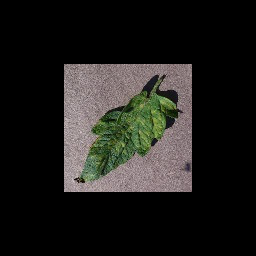

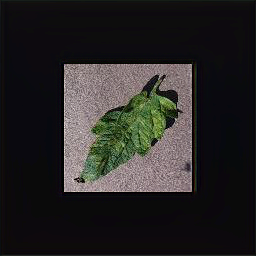

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Strawberry___Leaf_scorch/d63a4b03-0317-4385-9fa4-dd406158df53___RS_L.Scorch 0963_flipLR.JPG
/content/SelfDeblur/demo/fastec/329f2f31-ceca-402f-a007-21d64fe75f5e___Crnl_L.Mold 6519_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

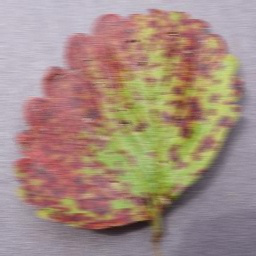

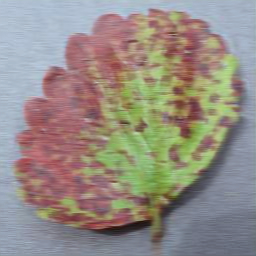

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Strawberry___Leaf_scorch/7e20f02a-24d1-4200-9a37-53a4d8c14d86___RS_L.Scorch 0019_flipLR.JPG
/content/SelfDeblur/demo/fastec/d63a4b03-0317-4385-9fa4-dd406158df53___RS_L.Scorch 0963_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

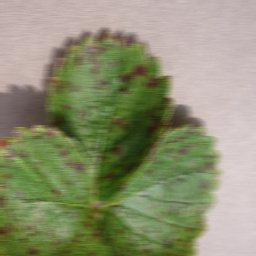

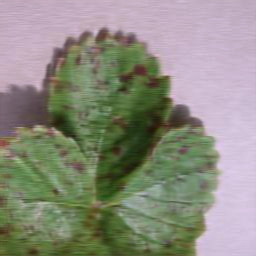

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Strawberry___Leaf_scorch/7c249f1b-15d5-4424-91cd-58b52e01cfdb___RS_L.Scorch 1141_flipLR.JPG
/content/SelfDeblur/demo/fastec/7e20f02a-24d1-4200-9a37-53a4d8c14d86___RS_L.Scorch 0019_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

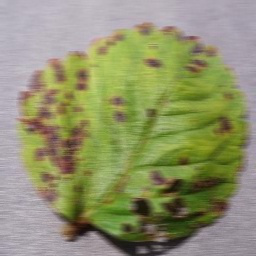

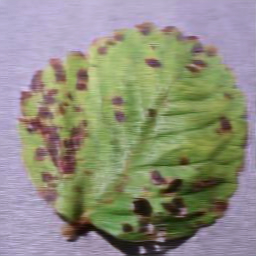

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Strawberry___Leaf_scorch/79c2506c-98e7-4e81-8daa-cc30fcc19436___RS_L.Scorch 9925_flipLR.JPG
/content/SelfDeblur/demo/fastec/7c249f1b-15d5-4424-91cd-58b52e01cfdb___RS_L.Scorch 1141_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

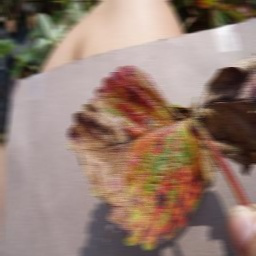

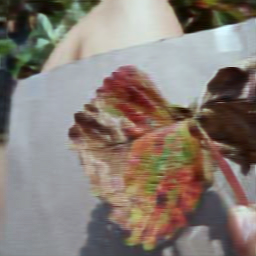

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Strawberry___Leaf_scorch/8408f04f-8155-403e-8906-f446f4d40acb___RS_L.Scorch 1476_flipLR.JPG
/content/SelfDeblur/demo/fastec/79c2506c-98e7-4e81-8daa-cc30fcc19436___RS_L.Scorch 9925_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

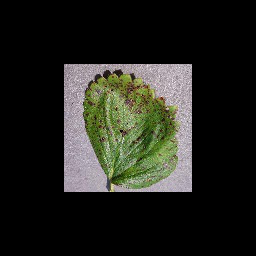

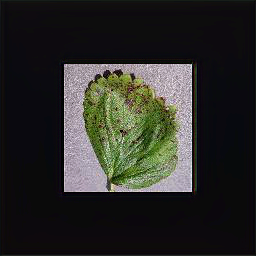

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Black_rot/9bdf0f8d-0a5a-4283-bf78-17d7462349f8___FAM_B.Rot 0645_flipLR.JPG
/content/SelfDeblur/demo/fastec/8408f04f-8155-403e-8906-f446f4d40acb___RS_L.Scorch 1476_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_b

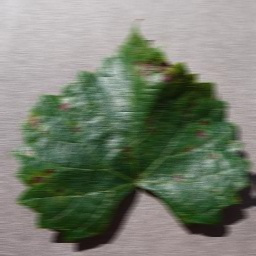

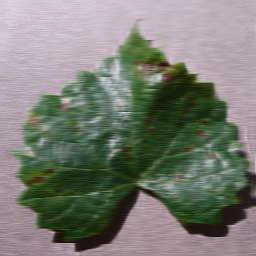

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Black_rot/30f1fd47-5562-44a1-8e3d-9339c3c12064___FAM_B.Rot 3022_flipLR.JPG
/content/SelfDeblur/demo/fastec/9bdf0f8d-0a5a-4283-bf78-17d7462349f8___FAM_B.Rot 0645_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_blo

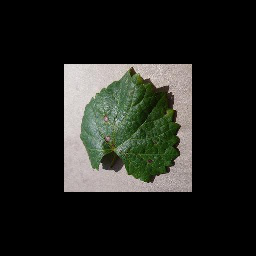

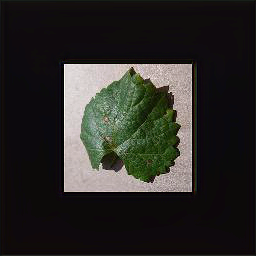

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Black_rot/e615e7ad-18b3-431c-b5fd-809aa7909c06___FAM_B.Rot 3276.JPG
/content/SelfDeblur/demo/fastec/30f1fd47-5562-44a1-8e3d-9339c3c12064___FAM_B.Rot 3022_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
   

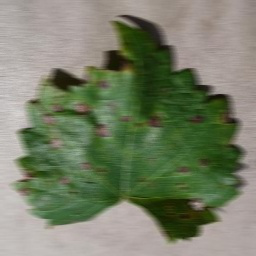

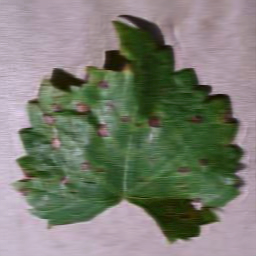

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Black_rot/b423ed33-9391-44ef-a942-77589460c59d___FAM_B.Rot 3508_flipLR.JPG
/content/SelfDeblur/demo/fastec/e615e7ad-18b3-431c-b5fd-809aa7909c06___FAM_B.Rot 3276.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
   

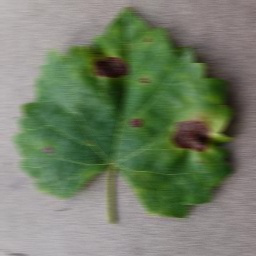

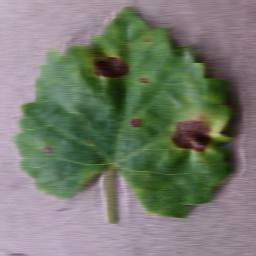

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Black_rot/a376b8ce-9cff-442f-a3b6-71e74a097876___FAM_B.Rot 0528_flipLR.JPG
/content/SelfDeblur/demo/fastec/b423ed33-9391-44ef-a942-77589460c59d___FAM_B.Rot 3508_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_blo

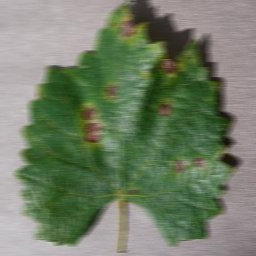

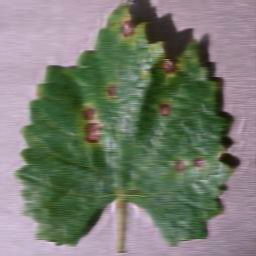

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___healthy/c6e3b06c-3fb3-4516-b663-dea564d907d8___RS_HL 6309_flipTB.JPG
/content/SelfDeblur/demo/fastec/a376b8ce-9cff-442f-a3b6-71e74a097876___FAM_B.Rot 0528_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
  

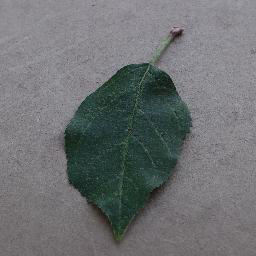

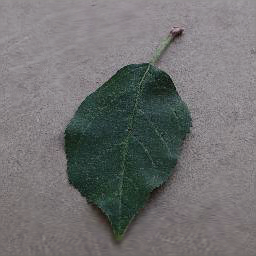

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___healthy/a4f33d84-f27c-481d-83ac-9575c8469fe6___RS_HL 7960.JPG
/content/SelfDeblur/demo/fastec/c6e3b06c-3fb3-4516-b663-dea564d907d8___RS_HL 6309_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (conv

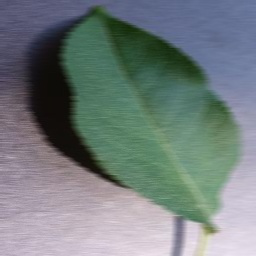

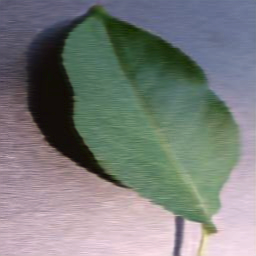

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___healthy/530f24d7-aefb-419d-b814-2cb3a81cfe2c___RS_HL 6071.JPG
/content/SelfDeblur/demo/fastec/a4f33d84-f27c-481d-83ac-9575c8469fe6___RS_HL 7960.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (conv_block)

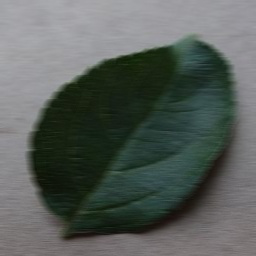

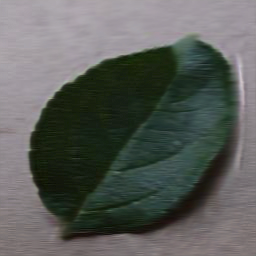

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___healthy/cb32fb76-f899-4c50-8599-2d9551ff036d___RS_HL 6084_flipTB.JPG
/content/SelfDeblur/demo/fastec/530f24d7-aefb-419d-b814-2cb3a81cfe2c___RS_HL 6071.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (conv

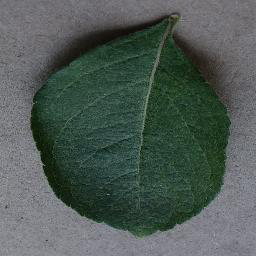

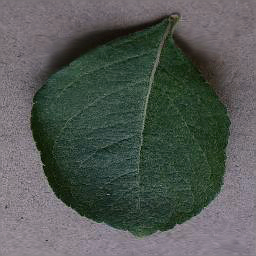

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___healthy/400723a1-65ae-4d62-b7c7-d8c0b7a02480___RS_HL 7479_flipTB.JPG
/content/SelfDeblur/demo/fastec/cb32fb76-f899-4c50-8599-2d9551ff036d___RS_HL 6084_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
      

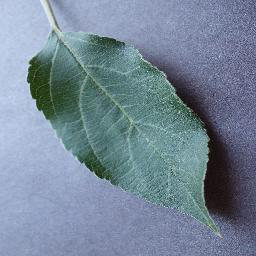

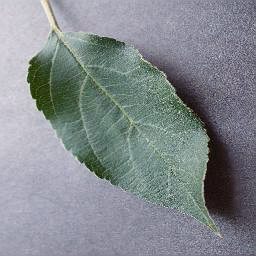

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Black_rot/b1fb1490-dd67-4f69-97a4-a770ab7c8301___JR_FrgE.S 8587_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/400723a1-65ae-4d62-b7c7-d8c0b7a02480___RS_HL 7479_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet

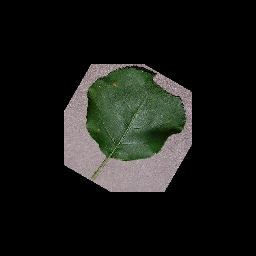

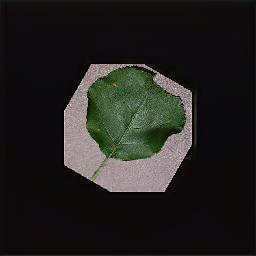

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Black_rot/acb4845c-bee1-478c-b11c-ade0ae397c51___JR_FrgE.S 8818_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/b1fb1490-dd67-4f69-97a4-a770ab7c8301___JR_FrgE.S 8587_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
     

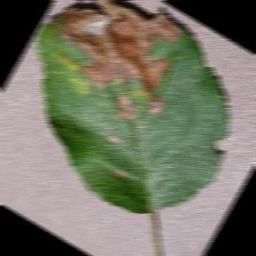

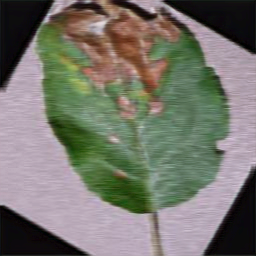

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Black_rot/a0d95497-da4c-40dd-bc2a-d29d1629bd4f___JR_FrgE.S 8759_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/acb4845c-bee1-478c-b11c-ade0ae397c51___JR_FrgE.S 8818_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
     

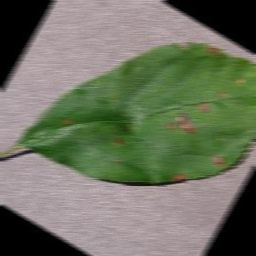

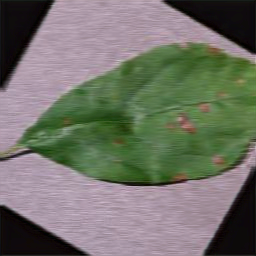

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Black_rot/cf524171-a68a-4200-9159-133567b95f71___JR_FrgE.S 8658.JPG
/content/SelfDeblur/demo/fastec/a0d95497-da4c-40dd-bc2a-d29d1629bd4f___JR_FrgE.S 8759_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bl

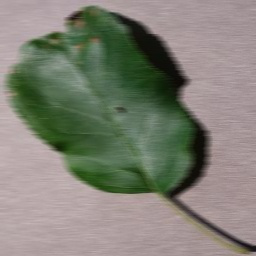

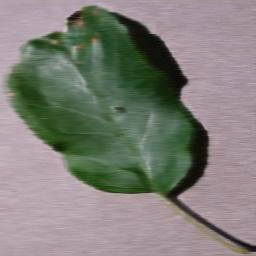

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Black_rot/5979896a-3aaa-4e0c-8b74-cfeda37cb166___JR_FrgE.S 2739_90deg.JPG
/content/SelfDeblur/demo/fastec/cf524171-a68a-4200-9159-133567b95f71___JR_FrgE.S 8658.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
    

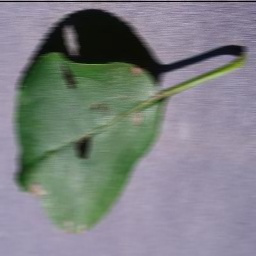

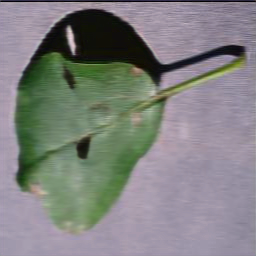

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/ccb23f86-a08c-4f4c-86b0-f9f6006b9ba0___FAM_L.Blight 1723_flipLR.JPG
/content/SelfDeblur/demo/fastec/5979896a-3aaa-4e0c-8b74-cfeda37cb166___JR_FrgE.S 2739_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
  

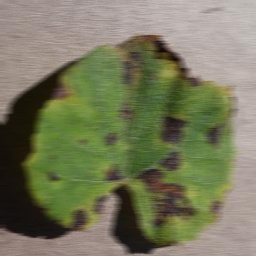

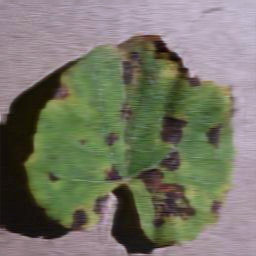

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/6fad4de0-54bf-4869-80ac-d290bd7d0da8___FAM_L.Blight 1432_flipLR.JPG
/content/SelfDeblur/demo/fastec/ccb23f86-a08c-4f4c-86b0-f9f6006b9ba0___FAM_L.Blight 1723_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        

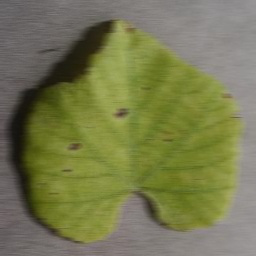

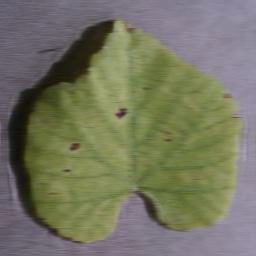

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/f2b27716-3d46-41b3-9937-c0fd76b93be2___FAM_L.Blight 4556.JPG
/content/SelfDeblur/demo/fastec/6fad4de0-54bf-4869-80ac-d290bd7d0da8___FAM_L.Blight 1432_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
     

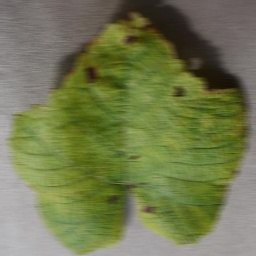

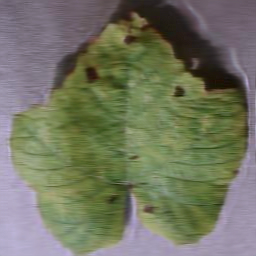

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/999e3735-a305-4048-8bcf-08995660e12e___FAM_L.Blight 4535.JPG
/content/SelfDeblur/demo/fastec/f2b27716-3d46-41b3-9937-c0fd76b93be2___FAM_L.Blight 4556.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
    

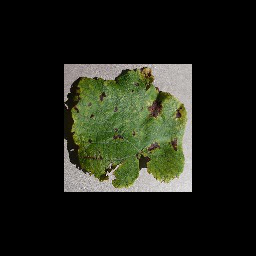

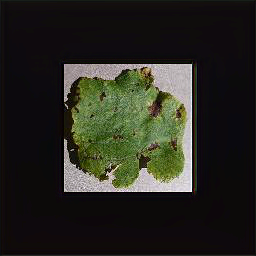

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/b07d0df0-b6b4-48fc-9771-c51cb20603ee___FAM_L.Blight 4941_flipLR.JPG
/content/SelfDeblur/demo/fastec/999e3735-a305-4048-8bcf-08995660e12e___FAM_L.Blight 4535.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
     

In [ ]:
test_path = '/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test'
import glob
import os
from PIL import Image

f1 = '/content/SelfDeblur/experiments/results_demo_fastec/*'
files = glob.glob(f1)
for k in files:
  print(k)
  os.remove(k)

for item in os.listdir(test_path):

  x = test_path + '/' + item 
  for item2 in os.listdir(x):
    src = x+ '/' + item2
    print(src)
    exit(0)
    f = '/content/SelfDeblur/demo/fastec/*'
    files = glob.glob(f)
    for k in files:
      print(k)
      os.remove(k)

    img = Image.open(src)
    new_dest = '/content/SelfDeblur/demo/fastec/' + item2
    # new_dest1 = '/content/SelfDeblur/demo/real/' + item2

    img.save(new_dest)
    # # img.save(new_dest1)

    !bash demo.sh
    # # # corrected_img_ = '/content/SelfDeblur/experiments/results_demo_fastec/0' + str(i).zfill(3) + '_pred.png' 
    corrected_img_ = '/content/SelfDeblur/experiments/results_demo_fastec/0000_pred.png'
    corrected_img = Image.open(corrected_img_)
    corrected_img.save(src)
    img.show()
    corrected_img.show()

    f = '/content/SelfDeblur/experiments/results_demo_fastec/*'
    files = glob.glob(f)
    for k in files:
      os.remove(k)

    
    # print("Done with: " + str(i + 1))
    # i = i+1

In [ ]:
new_model = to_device(ResNet9(3, 38), device) 
new_model

In [ ]:
valid_mod_dir = '/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test'
valid_mod = ImageFolder(valid_mod_dir, transform=transforms.ToTensor()) 
batch_size = 32
valid_mod_dl = DataLoader(valid_mod, batch_size, num_workers=2, pin_memory=True)
valid_mod_dl = DeviceDataLoader(valid_mod_dl, device)

In [ ]:
%%time
history = [evaluate(new_model, valid_mod_dl)]
history

In [ ]:
train = ImageFolder(train_dir, transform=transforms.ToTensor())
train_dl = DataLoader(train, batch_size, shuffle=True, num_workers=2, pin_memory=True)
train_dl = DeviceDataLoader(train_dl, device)

In [ ]:
epochs = 2
max_lr = 0.01
grad_clip = 0.1
weight_decay = 1e-4
opt_func = torch.optim.Adam

In [ ]:
%%time
history += fit_OneCycle(epochs, max_lr, new_model, train_dl, valid_mod_dl, 
                             grad_clip=grad_clip, 
                             weight_decay=1e-4, 
                             opt_func=opt_func)

In [ ]:
plot_accuracies(history)

### **On using the de-blurred dataset as validation dataset, we get a validation accuracy of 64.31%.**

## **Method 2: Using a dataset with real life pictures from fields: PlantDoc on our Model**

In [ ]:
# Dataset from : https://github.com/pratikkayal/PlantDoc-Dataset
# Download as given in : https://towardsdatascience.com/an-informative-colab-guide-to-load-image-datasets-from-github-kaggle-and-local-machine-75cae89ffa1e

In [ ]:
import os
os.mkdir('/content/tmp')

In [ ]:
import zipfile

!wget --no-check-certificate \
    "https://github.com/pratikkayal/PlantDoc-Dataset/archive/refs/heads/master.zip" \
    -O "tmp/crops.zip"

zip_ref = zipfile.ZipFile('tmp/crops.zip', 'r') #Opens the zip file in read mode
zip_ref.extractall('tmp') #Extracts the files into the /tmp folder
zip_ref.close()

In [ ]:
data_dir = "/content/tmp/PlantDoc-Dataset-master"
train_dir = data_dir + "/train"
valid_dir = data_dir + "/test"
diseases = os.listdir(train_dir)

In [ ]:
# datasets for validation and training
train = ImageFolder(train_dir, transform=transforms.ToTensor())
valid = ImageFolder(valid_dir, transform=transforms.ToTensor()) 

In [ ]:
model = to_device(ResNet9(3, len(train.classes)), device) 
model

In [ ]:
os.mkdir('/content/tmp/PlantDoc-Dataset-master/mod')
os.mkdir('/content/tmp/PlantDoc-Dataset-master/mod/train')
os.mkdir('/content/tmp/PlantDoc-Dataset-master/mod/test')

In [ ]:
import pathlib
import shutil

def make_image_folders(t):

  path =  '/content/tmp/PlantDoc-Dataset-master/' + t

  for(root, dirs, files) in os.walk(path):
    for item in dirs:
      x = '/content/tmp/PlantDoc-Dataset-master/mod/' + t + '/' + item
      if os.path.exists(x):
        print(item)
      else:
        os.mkdir(x)

In [ ]:
make_image_folders('train')
make_image_folders('test')

In [ ]:
def resize_and_import_images(t):

  path =  '/content/tmp/PlantDoc-Dataset-master/' + t

  for(root, dirs, files) in os.walk(path):

    if root == ("/content/tmp/PlantDoc-Dataset-master/" + t) :
      continue
    src = root
    # it = 0
    for item in os.listdir(src):
      x = pathlib.PurePath(src)
      y = x.name

      dest = "/content/tmp/PlantDoc-Dataset-master/mod/" + t + '/' + y
      # print("To be copied from " + src + "to " + dir_name )

      a = src + '/' + item
      b = dest + '/' + item

      if a.lower().endswith(('jpg', 'jpeg', 'png')):
        try:
          # length = len(a)
          # print(length)
          # if a[length - 7 : length - 4] == "png":
          #   continue

          image = Image.open(a)
          new_image = image.resize((256, 256))
          new_image.save(a)
          shutil.copy( a , b)

        except:
          continue

In [ ]:
resize_and_import_images('train')
resize_and_import_images('test')

In [ ]:
path = train_dir

for(root, dirs, files) in os.walk(path):
  for item in dirs:
    x = "/content/tmp/PlantDoc-Dataset-master/mod/test/" + item
    if os.path.exists(x):
      print(item)
    else:
      os.mkdir(x)

In [ ]:
for(root, dirs, files) in os.walk(path):

  if root == "/content/tmp/PlantDoc-Dataset-master/train":
    continue
  src = root
  # it = 0
  for item in os.listdir(src):
    x = pathlib.PurePath(src)
    y = x.name
    dest = "/content/tmp/PlantDoc-Dataset-master/mod/train/" + y
    # print("To be copied from " + src + "to " + dir_name )

    a = src + '/' + item
    b = dest + '/' + item
    # print(a)
    # print(b)

    if a.lower().endswith('jpg'):
      try:
        len = a.length
        # if(a[len - 7 : len - 4] == "png"):
        #   continue
        image = Image.open(a)
        new_image = image.resize((256, 256))
        new_image.save(a)
        shutil.copy( a , b)
      except:
        continue

    # '/content/tmp/PlantDoc-Dataset-master/mod_dir/train/Strawberry leaf/stock-photo-strawberry-leaf-isolated-on-white-background-572055775.jpg'
    # /content/tmp/PlantDoc-Dataset-master/train/Strawberry leaf/stock-photo-strawberry-leaf-isolated-on-the-white-background-255533380.jpg

In [ ]:
path = valid_dir

for(root, dirs, files) in os.walk(path):
  for item in dirs:
    x = "/content/tmp/PlantDoc-Dataset-master/mod/test/" + item
    if os.path.exists(x):
      print(item)
    else:
      os.mkdir(x)

In [ ]:
for(root, dirs, files) in os.walk(path):

  if root == "/content/tmp/PlantDoc-Dataset-master/test":
    continue
  src = root
  # it = 0
  for item in os.listdir(src):
    x = pathlib.PurePath(src)
    y = x.name
    dest = "/content/tmp/PlantDoc-Dataset-master/mod/test/" + y
    # print("To be copied from " + src + "to " + dir_name )

    a = src + '/' + item
    b = dest + '/' + item
    print(a)
    print(b)

    if a.lower().endswith('jpg'):
      try:
        len = a.length
        if(a[len - 7 : len - 4] == "png"):
          continue
        image = Image.open(a)
        new_image = image.resize((256, 256))
        new_image.save(a)
        shutil.copy( a , b)
      except:
        continue

In [ ]:
train_dir = '/content/tmp/PlantDoc-Dataset-master/mod/train'
valid_dir = '/content/tmp/PlantDoc-Dataset-master/mod/test'


train = ImageFolder(train_dir, transform=transforms.ToTensor())
# valid = ImageFolder(valid_dir, transform=transforms.ToTensor()) 

# DataLoaders for training and validation
batch_size = 32
train_dl = DataLoader(train, batch_size, shuffle=True, num_workers=2, pin_memory=True)
# valid_dl = DataLoader(valid, batch_size, num_workers=2, pin_memory=True)

show_batch(train_dl) 

In [ ]:
random_seed = 7
torch.manual_seed(random_seed)

In [ ]:
os.rmdir('/content/tmp/PlantDoc-Dataset-master/mod/test/.ipynb_checkpoints')
valid = ImageFolder(valid_dir, transform=transforms.ToTensor()) 
valid_dl = DataLoader(valid, batch_size, num_workers=2, pin_memory=True)


In [ ]:
# Moving data into GPU
train_dl = DeviceDataLoader(train_dl, device)
valid_dl = DeviceDataLoader(valid_dl, device)

In [ ]:
%%time
history = [evaluate(model, valid_dl)]
history

In [ ]:
epochs = 50
max_lr = 0.01
grad_clip = 0.1
weight_decay = 1e-4
opt_func = torch.optim.Adam

In [ ]:
%%time
history += fit_OneCycle(epochs, max_lr, model, train_dl, valid_dl, 
                             grad_clip=grad_clip, 
                             weight_decay=1e-4, 
                             opt_func=opt_func)

### **Our model gives a validation accuracy of 21.48% on the PlantDoc dataset.**

# **Method 3: Synthesising images from a GAN**

In [ ]:
from __future__ import print_function, division
import sklearn as sk
from keras import backend as K
import matplotlib.gridspec as gridspec
from sklearn.metrics import classification_report
from keras.layers import multiply
from keras.layers import Embedding
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Reshape
from keras.layers.convolutional import UpSampling2D
from subprocess import check_output

In [ ]:
import numpy as np
import os
import imageio
import pickle
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense
from keras.layers import Flatten
from keras.layers import Activation
from keras.layers import Dropout
from keras.layers import ZeroPadding2D
from keras.layers.convolutional import Conv2D
from keras.layers.pooling import MaxPooling2D
from keras.layers import BatchNormalization
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
# from keras.layers.advanced_activations import LeakyReLU
from keras.layers import ELU, PReLU, LeakyReLU
from keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from skimage.transform import resize as imresize
from tqdm import tqdm
import pandas as pd
from keras import regularizers
from functools import partial
# from keras.layers.merge import _Merge
from keras.layers import add, concatenate

In [ ]:
class RandomWeightedAverage():   ####
    """Provides a (random) weighted average between real and generated image samples"""
    def _merge_function(self, inputs):
        alpha = K.random_uniform((100, 1, 1, 1))
        return (alpha * inputs[0]) + ((1 - alpha) * inputs[1])

In [ ]:
class DCGAN():
    def __init__(self):
        # Input shape
        self.epi=0.22
        self.img_rows = 128
        self.img_cols = 128
        self.channels = 3
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = 1000
        self.num_classes = 38
        def custom_objective(y_true, y_pred):
            epi = self.epi

            # out = -epi+(1-epi)*K.sparse_categorical_crossentropy(y_true, y_pred)
            out = -epi * (K.mean(K.log(y_pred + 0.00000001))) + (1 - epi) * K.sparse_categorical_crossentropy(y_true, y_pred)
            return out
        self.n_critic = 5
        optimizer = RMSprop(lr=0.00005)

        # Build and compile the discriminator
        self.generator = self.build_generator()
        # self.generator.load_weights('generator_weights.hdf5')
        self.critic = self.build_critic()
        # self.critic.load_weights('discriminator_weights.hdf5')
        self.generator.trainable = False
        real_img = Input(shape=self.img_shape)

        # Noise input
        z_disc = Input(shape=(self.latent_dim,))
        label = Input(shape=(1,))
        # Generate image based of noise (fake sample)
        fake_img = self.generator([z_disc,label])

        fake,fake_label = self.critic(fake_img)
        valid, valid_label = self.critic(real_img)

        # Construct weighted average between real and fake images
        interpolated_img = RandomWeightedAverage._merge_function(self,[real_img, fake_img])
        # Determine validity of weighted sample
        validity_interpolated, inter_label = self.critic(interpolated_img)
        partial_gp_loss = partial(self.gradient_penalty_loss,
                          averaged_samples=interpolated_img)
        partial_gp_loss.__name__ = 'gradient_penalty' # Keras requires function names

        self.critic_model = Model(inputs=[real_img, z_disc, label],
                            outputs=[valid, fake, validity_interpolated,valid_label,fake_label])
        self.critic_model.compile(loss=[self.wasserstein_loss,self.wasserstein_loss, partial_gp_loss,custom_objective,custom_objective],
                                        optimizer=optimizer,
                                        loss_weights=[1, 1, 10, 2, 2 ])
        self.critic.trainable = False
        self.generator.trainable = True

        # Sampled noise for input to generator
        z_gen = Input(shape=(self.latent_dim,))
        label_zen=Input(shape=(1,))
        # Generate images based of noise
        img = self.generator([z_gen,label_zen])
        # Discriminator determines validity
        valid,valid_label = self.critic(img)
        # Defines generator model
        self.generator_model = Model([z_gen,label_zen], [valid,valid_label])
        self.generator_model.compile(loss=[self.wasserstein_loss,custom_objective], optimizer=optimizer)


    def gradient_penalty_loss(self, y_true, y_pred, averaged_samples):
        """
        Computes gradient penalty based on prediction and weighted real / fake samples
        """
        gradients = K.gradients(y_pred, averaged_samples)[0]
        # compute the euclidean norm by squaring ...
        gradients_sqr = K.square(gradients)
        #   ... summing over the rows ...
        gradients_sqr_sum = K.sum(gradients_sqr,
                                  axis=np.arange(1, len(gradients_sqr.shape)))
        #   ... and sqrt
        gradient_l2_norm = K.sqrt(gradients_sqr_sum)
        # compute lambda * (1 - ||grad||)^2 still for each single sample
        gradient_penalty = K.square(1 - gradient_l2_norm)
        # return the mean as loss over all the batch samples
        return K.mean(gradient_penalty)


    def wasserstein_loss(self, y_true, y_pred):
        return K.mean(y_true * y_pred)  

    def build_critic(self):
        model = Sequential()
        model.add(Conv2D(16, kernel_size=3, strides=2, input_shape=self.img_shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(32, kernel_size=3, strides=2, padding="same"))
        model.add(ZeroPadding2D(padding=((0,1),(0,1))))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(128, kernel_size=3, strides=1, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Flatten())
        model.summary()
        img = Input(shape=self.img_shape)
        features = model(img)
        validity = Dense(1, activation="sigmoid")(features)
        label = Dense(self.num_classes + 1, activation="softmax")(features)
        return Model(img, [validity, label])
  
    def build_generator(self):

        model = Sequential()

        model.add(Dense(128 * 8 * 8, activation="relu", input_dim=self.latent_dim))
        model.add(Reshape((8, 8, 128)))
        model.add(UpSampling2D())
        model.add(Conv2D(128, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        model.add(Conv2D(64, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        model.add(Conv2D(32, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        model.add(Conv2D(self.channels, kernel_size=3, padding="same"))
        model.add(Activation("tanh"))
        model.summary()
        noise = Input(shape=(self.latent_dim,))
        label = Input(shape=(1,), dtype='int32')
        label_embedding = Flatten()(Embedding(self.num_classes, self.latent_dim)(label))
        model_input = multiply([noise, label_embedding])
        img = model(model_input)
        return Model([noise, label], img)

    def train(self, epochs, batch_size=128, sample_interval=50):
        # Load the dataset
        X_train, x_valid, y_train, y_valid = self.X_train, self.x_valid, self.y_train, self.y_valid
        y_train = y_train.reshape(-1, 1)
        valid = -np.ones((batch_size, 1))
        fake = np.ones((batch_size, 1))
        dummy = np.zeros((batch_size, 1))
        for epoch in range(epochs):
            for _ in range(self.n_critic):
            # ---------------------
            #  Train Discriminator
            # ---------------------

            # Select a random half of images
                idx = np.random.randint(0, X_train.shape[0], batch_size)
                imgs = X_train[idx]
                img_labels = y_train[idx]
                noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
                sampled_labels =img_labels
                fake_labels = self.num_classes * np.ones(img_labels.shape)
            d_loss = self.critic_model.train_on_batch([imgs, noise, sampled_labels],
                                                      [valid, fake, dummy, sampled_labels,fake_labels])
            g_loss = self.generator_model.train_on_batch([noise,sampled_labels], [valid,sampled_labels])
            print("%d [D loss: %f, acc.: %.2f%%, op_acc: %.2f%%] [G loss: %f]" % (
                epoch, d_loss[0], 100 * d_loss[3], 100 * d_loss[4], g_loss[0]))
            if epoch % sample_interval == 0:
                self.save_model()
                self.sample_images(epoch)

    def sample_images(self, epoch):
        r, c = 10, self.num_classes
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        sampled_labels = np.array([num for _ in range(r) for num in range(c)])
        gen_imgs = self.generator.predict([noise, sampled_labels])
        gen_imgs = 0.5 * gen_imgs + 0.5
        fig = plt.figure()
        gs = gridspec.GridSpec(6, 7,
                               wspace=0.0, hspace=0.0)
        cnt = 0
        for i in range(6):
            for j in range(7):
                im=gen_imgs[cnt, :, :, 0:3]
                ax = plt.subplot(gs[i, j])
                ax.imshow(im)
                ax.axis('off')
                cnt += 1
        fig.savefig("%d.png" % epoch)
        plt.close()

    def save_model(self):
        def save(model, model_name):
            model_path = "%s.json" % model_name
            weights_path = "%s_weights.hdf5" % model_name
            options = {"file_arch": model_path,
                       "file_weight": weights_path}
            json_string = model.to_json()
            open(options['file_arch'], 'w').write(json_string)
            model.save_weights(options['file_weight'])

        save(self.generator, "generator")
        save(self.critic, "discriminator")

In [ ]:
acgan = DCGAN()

In [ ]:
def train_model(img,target,a,b,c,d):

    gmodel = ResNet9(3,38)
    # gmodel.summary()
    INPUT_SHAPE = (3, 256, 256)
    print(summary(gmodel.cuda(), (INPUT_SHAPE)))

    if d!=0:
     gmodel.load_weights(filepath='/content/Model/wgan_weights.h5')

    gen = ImageDataGenerator(
        rotation_range=360.,
        width_shift_range=0.3,
        height_shift_range=0.3,
        zoom_range=0.3,
        horizontal_flip=True,
        vertical_flip=True
    )
    # history = gmodel.fit_generator(gen.flow(img, target, batch_size=BATCH_SIZE),
    #                     steps_per_epoch=len(img) / BATCH_SIZE,
    #                      epochs=c,
    #                      verbose=1,
    #                      shuffle=True,
    #                      validation_data=(a, to_categorical(b)))
    # history = gmodel.fit(img, to_categorical(target), batch_size=BATCH_SIZE,
    #                      epochs=c, verbose=1, shuffle=True,
    #                      validation_data=(a, to_categorical(b)))

    max_lr = 0.01
    grad_clip = 0.1
    weight_decay = 0.0001
    opt_func = torch.optim.Adam

    history = fit_OneCycle(epochs=c, max_lr=max_lr, model=gmodel, train_loader=img, val_loader=target, 
                             grad_clip=grad_clip, 
                             weight_decay=weight_decay, 
                             opt_func=opt_func)

    model_json = gmodel.to_json()
    with open("/content/Model/wgan.json", "w") as json_file:
        json_file.write(model_json)
    # serialize weights to HDF5
    gmodel.save_weights("/content/Model/wgan_weights.h5")
    # list all data in history
    print(history.history.keys())

    global MAX,ep,result_max
    if np.max(history.history['val_acc'])>MAX:
        MAX=np.max(history.history['val_acc'])
        y_pred_max = (gmodel.predict(a)).argmax(axis=-1)
        result_max = sk.metrics.confusion_matrix(b,y_pred_max)
        ep=d

    print("hey")

    print((MAX,ep))
    dataframe = pd.DataFrame({'acc': history.history['acc'], 'val_acc': history.history['val_acc']})
    filename="wgan_record"+str(d)+".csv"
    dataframe.to_csv( filename, index=False, sep=',')
    plt.plot(history.history['acc'])
    plt.plot(history.history['val_acc'])
    plt.title('Prediction Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()


In [ ]:
DEFAULT_IMAGE_SIZE = ((128,128))
N_IMAGES = 50
root_dir = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir"
train_dir = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train"
test_dir = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test"

In [ ]:
from tensorflow.keras.utils import img_to_array

def convert_img_to_arr(image_dir):

  try:
    image = cv2.imread(image_dir)
    if image is not None:
      image = cv2.resize(image, DEFAULT_IMAGE_SIZE)
      return img_to_array(image)
    else:
      return np.array([])
  except Exception as e:
      print(f"Error: {e}")
      return None

In [ ]:
import cv2
import tensorflow as tf

image_list, label_list = [], []

print("Loading Images....")
plant_disease_folders = os.listdir(train_dir)

for folder in plant_disease_folders:
  print(f"Processing {folder}..")
  plant_images = os.listdir(f"{train_dir}/{folder}/")

  for image in plant_images[:N_IMAGES]:
    image_dir = f"{train_dir}/{folder}/{image}"
    if image_dir.endswith(".jpg")==True or image_dir.endswith(".JPG")==True:
      image_list.append(convert_img_to_arr(image_dir))
      label_list.append(folder)

  print("Image loading completed")

np_img_list = np.array(image_list, dtype = np.float16) / 225.0
print()

image_len = len(image_list)
print(f"Total number of images: {image_len}")

In [ ]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer()
img_labels = label_binarizer.fit_transform(label_list)
n_classes = len(label_binarizer.classes_)

print("Total number of classes: ", n_classes)

In [ ]:
x_train, x_valid, y_train, y_valid = train_test_split(np_img_list, img_labels, test_size = 0.2, random_state = 42)
print("original train size",x_train.shape)

r, c = 200, 38

In [ ]:
for k in range(14):

    noise = np.random.normal(0, 1, (r * c, 1000)) 
    sampled_labels = np.array([num for _ in range(r) for num in range(c)])
    gen_imgs = acgan.generator.predict([noise, sampled_labels])

    gen_validity, gen_plabels=acgan.critic.predict(gen_imgs)

    gen_imgs=gen_imgs[gen_validity[:,0]>0.5]
    gen_labels=np.asarray(np.argmax(gen_plabels, axis=1))
    gen_labels=gen_labels[gen_validity[:,0]>0.5]

    num_38 =np.sum(gen_labels==38)
    num_total, =gen_labels.shape

    gen_imgs=gen_imgs[gen_labels<38]
    gen_labels = gen_labels[gen_labels<38]
    gen_imgs = gen_imgs.resize((256,256,3))

    gen_labels_arr = np.array([])
    gen_labels_arr.resize(gen_labels.shape[0], 38);
    for i in range (gen_labels.shape[0]):
      for j in range (38):
        if (j == gen_labels[i]):
          gen_labels_arr[i][j] = 1;
        else:
          gen_labels_arr[i][j] = 0;
          
    # print(gen_labels_arr)

    y_valid = to_categorical(y_valid, 38)
    y_train_reg = np.concatenate((y_train, gen_labels_arr), axis=0)
    x_train_reg = np.concatenate((x_train, gen_imgs), axis=0)

    train_model(x_train_reg, y_train_reg, x_valid, y_valid, 50, k)

## **On using GAN to generate crop images, the model gives a validation accuracy of 25.07%.**